In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import timedelta

In [2]:
df_countries = pd.read_csv('/Users/nina/data/top_200_password_2020_by_country.csv')

In [3]:
df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds
0,au,Australia,1,123456,308483,< 1 second,1.0,0
1,au,Australia,2,password,191880,< 1 second,5.0,0
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800
3,au,Australia,4,password1,86884,< 1 second,16.0,0
4,au,Australia,5,123456789,75856,< 1 second,2.0,0
...,...,...,...,...,...,...,...,...
9795,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800
9796,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020
9797,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800
9798,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200


UNIQUE PASSWORDS

In [5]:
# unique list of passwords in this dataset
unique_password_list = df_countries["Password"].drop_duplicates()

In [6]:
unique_password_list

0          123456
1        password
2        lizottes
3       password1
4       123456789
          ...    
9795     hongngoc
9796      anhtien
9797     lanhuong
9798     congacon
9799     conmemay
Name: Password, Length: 4255, dtype: object

In [7]:
password_count = df_countries["Password"].value_counts()

In [8]:
password_count

Password
123456       49
password     49
123456789    49
12345        49
12345678     49
             ..
narayana      1
Senti123      1
chinnu        1
rashmi        1
conmemay      1
Name: count, Length: 4255, dtype: int64

In [9]:
# unique list of countries in this dataset
unique_countries_list = df_countries["country"].drop_duplicates()

In [10]:
unique_countries_list.count()

49

In [11]:
unique_passwords = pd.DataFrame()
unique_passwords["Password"] = unique_password_list
unique_passwords['Password_Count'] = unique_passwords['Password'].map(password_count)

In [12]:
unique_passwords

,Password,Password_Count
0,123456,49
1,password,49
2,lizottes,1
3,password1,39
4,123456789,49
...,...,...
9795,hongngoc,1
9796,anhtien,1
9797,lanhuong,1
9798,congacon,1


In [13]:
unique_passwords = unique_passwords[unique_passwords["Password_Count"]==1]

In [14]:
unique_passwords

,Password,Password_Count
2,lizottes,1
18,australia,1
26,tigers,1
42,guest,1
53,bulldogs,1
...,...,...
9795,hongngoc,1
9796,anhtien,1
9797,lanhuong,1
9798,congacon,1


In [15]:
# how many unique passwords does each country have?
unique_password_list = []
for password in df_countries["Password"]:
    if password in unique_passwords["Password"].values:
        unique_password_list.append(True)
    else:
        unique_password_list.append(False)
df_countries["unique_password"] = unique_password_list

In [16]:
df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password
0,au,Australia,1,123456,308483,< 1 second,1.0,0,False
1,au,Australia,2,password,191880,< 1 second,5.0,0,False
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800,True
3,au,Australia,4,password1,86884,< 1 second,16.0,0,False
4,au,Australia,5,123456789,75856,< 1 second,2.0,0,False
...,...,...,...,...,...,...,...,...,...
9795,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800,True
9796,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020,True
9797,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800,True
9798,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200,True


In [17]:
# count of unique passwords per country
unique_country_count = pd.DataFrame()
unique_country_count["country"] = unique_countries_list.reset_index(drop=True)
unique_password_count_per_country_list = []

for country in unique_country_count["country"]:
    unique_password_count_per_country_list.append(df_countries[df_countries["country"]==country]["unique_password"].sum())

unique_country_count["unique_passwords"] = unique_password_count_per_country_list

In [18]:
unique_country_count

,country,unique_passwords
0,Australia,39
1,Austria,45
2,Belgium,36
3,Brazil,37
4,Canada,9
5,Chile,59
6,China,132
7,Colombia,34
8,Czech Republic,59
9,Denmark,55


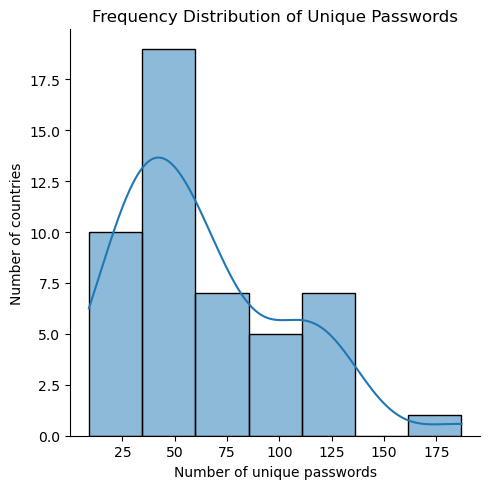

In [19]:
sns.displot(unique_country_count["unique_passwords"], kde=True)
plt.title('Frequency Distribution of Unique Passwords')
plt.xlabel('Number of unique passwords')
plt.ylabel('Number of countries')
plt.tight_layout()
plt.savefig("histogram-unique-passwords.png",dpi=300,transparent=True)

In [20]:
unique_country_count["unique_passwords"].describe()

count     49.000000
mean      63.428571
std       39.440884
min        9.000000
25%       36.000000
50%       55.000000
75%       86.000000
max      187.000000
Name: unique_passwords, dtype: float64

In [21]:
# WEBINAR 2 - what kind of vars
df_countries
# unique_password - derived during data exploration - categorical? ordinal?

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password
0,au,Australia,1,123456,308483,< 1 second,1.0,0,False
1,au,Australia,2,password,191880,< 1 second,5.0,0,False
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800,True
3,au,Australia,4,password1,86884,< 1 second,16.0,0,False
4,au,Australia,5,123456789,75856,< 1 second,2.0,0,False
...,...,...,...,...,...,...,...,...,...
9795,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800,True
9796,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020,True
9797,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800,True
9798,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200,True


EXTRA COLUMNS

In [23]:
# create 2 extra columns (region, password type)

In [24]:
# add another column region for each country
asia_and_middle_east_countries = ["Vietnam", "United Arab Emirates", "Thailand", "Turkey", "Saudi Arabia", "Philippines", "Australia", "China", "India", "Indonesia", "Israel", "Japan", "Korea", "Malaysia", "New Zealand"]
europe_and_africa_countries = ["United Kingdom", "Ukraine", "Spain", "Sweden", "Switzerland", "South Africa", "Slovak Republic", "Russia", "Poland", "Portugal", "Norway", "Romania", "Nigeria", "Netherlands", "Lithuania", "Latvia", "Ireland", "Italy", "Austria", "Belgium", "Czech Republic", "Denmark", "Estonia", "Finland", "France", "Germany", "Greece", "Hungary"]
americas_countries = ["United States", "Brazil", "Canada", "Chile", "Colombia", "Mexico"]

In [25]:
region_column = []
for country in df_countries["country"]:
    if country in americas_countries:
        region_column.append("Americas")
    elif country in europe_and_africa_countries:
        region_column.append("Europe/Africa")
    elif country in asia_and_middle_east_countries:
        region_column.append("Asia")
    else:
        region_column.append("not found")
        print("not found for {}".format(country))

df_countries["region"] = region_column
df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region
0,au,Australia,1,123456,308483,< 1 second,1.0,0,False,Asia
1,au,Australia,2,password,191880,< 1 second,5.0,0,False,Asia
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800,True,Asia
3,au,Australia,4,password1,86884,< 1 second,16.0,0,False,Asia
4,au,Australia,5,123456789,75856,< 1 second,2.0,0,False,Asia
...,...,...,...,...,...,...,...,...,...,...
9795,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800,True,Asia
9796,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020,True,Asia
9797,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800,True,Asia
9798,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200,True,Asia


In [26]:
# add another column password_type for each password - string, numbers, combo
password_type_column = []
for password in df_countries["Password"]:
    if password.isdigit():
        password_type_column.append("digits")
    elif password.isalpha():
        password_type_column.append("chars")
    else:
        password_type_column.append("combo")

df_countries["password_type"] = password_type_column
df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type
0,au,Australia,1,123456,308483,< 1 second,1.0,0,False,Asia,digits
1,au,Australia,2,password,191880,< 1 second,5.0,0,False,Asia,chars
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800,True,Asia,chars
3,au,Australia,4,password1,86884,< 1 second,16.0,0,False,Asia,combo
4,au,Australia,5,123456789,75856,< 1 second,2.0,0,False,Asia,digits
...,...,...,...,...,...,...,...,...,...,...,...
9795,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800,True,Asia,chars
9796,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020,True,Asia,chars
9797,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800,True,Asia,chars
9798,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200,True,Asia,chars


TYPES OF PASSWORDS

In [28]:
# worldwide distribution of type of passwords
password_type_dist = df_countries[["country","Password","region","password_type", "Time_to_crack_in_seconds"]]
password_type_dist

,country,Password,region,password_type,Time_to_crack_in_seconds
0,Australia,123456,Asia,digits,0
1,Australia,password,Asia,chars,0
2,Australia,lizottes,Asia,chars,10800
3,Australia,password1,Asia,combo,0
4,Australia,123456789,Asia,digits,0
...,...,...,...,...,...
9795,Vietnam,hongngoc,Asia,chars,10800
9796,Vietnam,anhtien,Asia,chars,1020
9797,Vietnam,lanhuong,Asia,chars,10800
9798,Vietnam,congacon,Asia,chars,7200


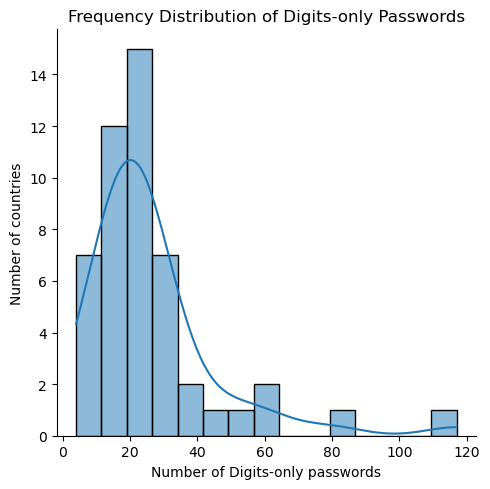

In [29]:
sns.displot(password_type_dist[password_type_dist["password_type"]=="digits"].groupby("country").size(), kde=True)
plt.title('Frequency Distribution of Digits-only Passwords')
plt.xlabel('Number of Digits-only passwords')
plt.ylabel('Number of countries')
plt.tight_layout()
plt.savefig("histogram-digits.png",dpi=300,transparent=True)

In [30]:
password_type_dist[password_type_dist["password_type"]=="digits"].groupby("country").size().describe()

count     49.000000
mean      26.469388
std       19.779095
min        4.000000
25%       15.000000
50%       21.000000
75%       29.000000
max      117.000000
dtype: float64

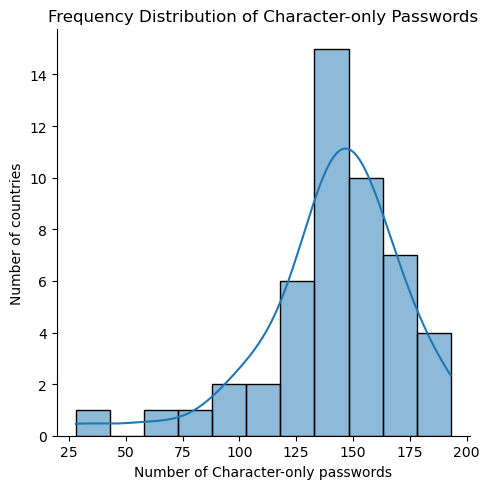

In [31]:
sns.displot(password_type_dist[password_type_dist["password_type"]=="chars"].groupby("country").size(), kde=True)
plt.title('Frequency Distribution of Character-only Passwords')
plt.xlabel('Number of Character-only passwords')
plt.ylabel('Number of countries')
plt.tight_layout()
plt.savefig("histogram-chars.png",dpi=300,transparent=True)

In [32]:
password_type_dist[password_type_dist["password_type"]=="chars"].groupby("country").size().describe()

count     49.000000
mean     141.285714
std       30.957632
min       28.000000
25%      131.000000
50%      146.000000
75%      160.000000
max      193.000000
dtype: float64

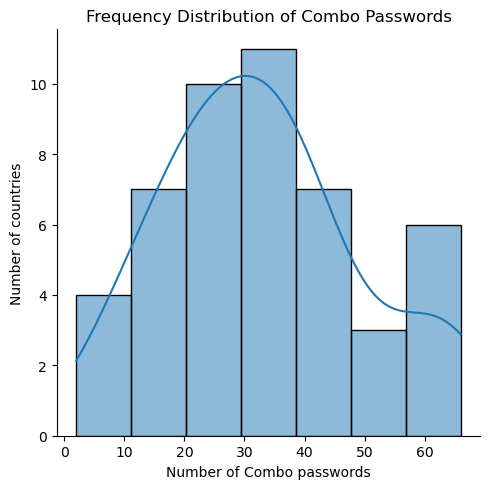

In [33]:
sns.displot(password_type_dist[password_type_dist["password_type"]=="combo"].groupby("country").size(), kde=True)
plt.title('Frequency Distribution of Combo Passwords')
plt.xlabel('Number of Combo passwords')
plt.ylabel('Number of countries')
plt.tight_layout()
plt.savefig("histogram-combo.png",dpi=300,transparent=True)

In [34]:
password_type_dist[password_type_dist["password_type"]=="combo"].groupby("country").size().describe()

count    48.000000
mean     32.916667
std      16.271413
min       2.000000
25%      21.750000
50%      31.500000
75%      41.000000
max      66.000000
dtype: float64

In [35]:
# the number of bins instead of setting it to a hardcoded value - can use three rule options
# Square Root Rule: bins = int(np.sqrt(len(data)))
# Sturges' Rule: bins = int(np.ceil(np.log2(len(data)) + 1))
# Freedman-Diaconis' Rule: This takes into account the interquartile range (IQR) and is more robust for skewed distributions.
import numpy as np

def calculate_bins_fd(data):
    IQR = np.percentile(data, 75) - np.percentile(data, 25)
    bin_width = 2 * IQR / np.cbrt(len(data))  # Freedman-Diaconis formula
    return int(np.ceil((max(data) - min(data)) / bin_width))

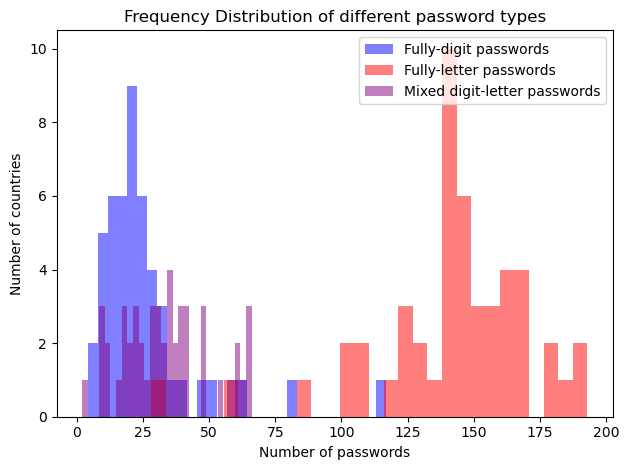

In [36]:
# see all 3 histograms in the same view worldwide
plt.hist(password_type_dist[password_type_dist["password_type"]=="digits"].groupby("country").size(), bins=30, alpha=0.5, label='Fully-digit passwords', color='blue')
plt.hist(password_type_dist[password_type_dist["password_type"]=="chars"].groupby("country").size(), bins=30, alpha=0.5, label='Fully-letter passwords', color='red')
plt.hist(password_type_dist[password_type_dist["password_type"]=="combo"].groupby("country").size(), bins=30, alpha=0.5, label='Mixed digit-letter passwords', color='purple')
plt.title('Frequency Distribution of different password types')
plt.xlabel('Number of passwords')
plt.ylabel('Number of countries')
plt.legend()
plt.tight_layout()
plt.savefig("histogram-diff-types-30-bins.png",dpi=300,transparent=True)

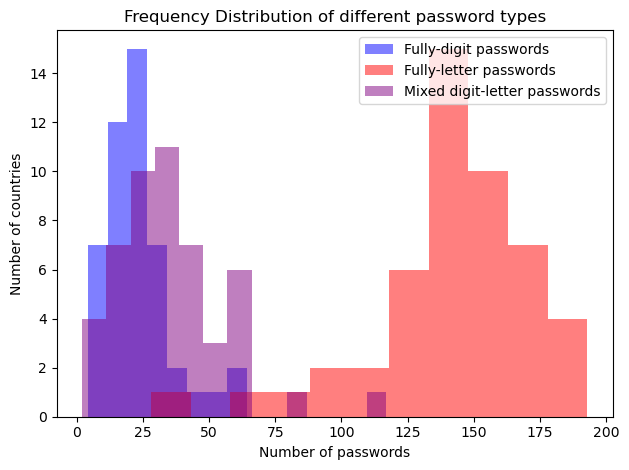

In [37]:
# see all 3 histograms in the same view worldwide
plt.hist(password_type_dist[password_type_dist["password_type"]=="digits"].groupby("country").size(), bins=calculate_bins_fd(password_type_dist[password_type_dist["password_type"]=="digits"].groupby("country").size()), alpha=0.5, label='Fully-digit passwords', color='blue')
plt.hist(password_type_dist[password_type_dist["password_type"]=="chars"].groupby("country").size(), bins=calculate_bins_fd(password_type_dist[password_type_dist["password_type"]=="chars"].groupby("country").size()), alpha=0.5, label='Fully-letter passwords', color='red')
plt.hist(password_type_dist[password_type_dist["password_type"]=="combo"].groupby("country").size(), bins=calculate_bins_fd(password_type_dist[password_type_dist["password_type"]=="combo"].groupby("country").size()), alpha=0.5, label='Mixed digit-letter passwords', color='purple')
plt.title('Frequency Distribution of different password types')
plt.xlabel('Number of passwords')
plt.ylabel('Number of countries')
plt.legend()
plt.tight_layout()
plt.savefig("histogram-diff-types-flexible-bins.png",dpi=300,transparent=True)

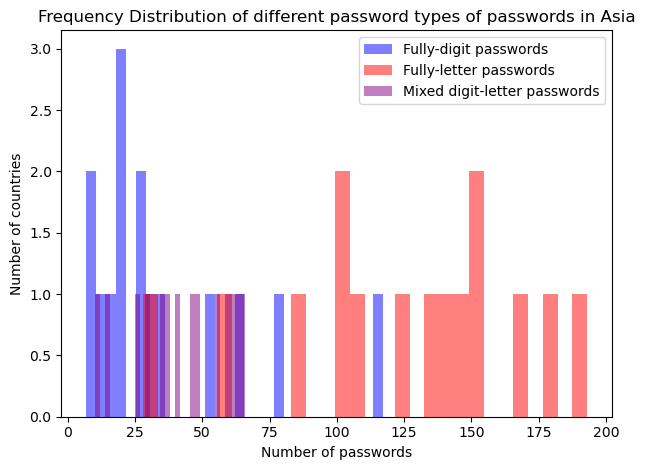

In [38]:
# see all 3 histograms in the same view for asia
plt.hist(password_type_dist[(password_type_dist["password_type"]=="digits") & (password_type_dist["region"]=="Asia")].groupby("country").size(), bins=30, alpha=0.5, label='Fully-digit passwords', color='blue')
plt.hist(password_type_dist[(password_type_dist["password_type"]=="chars") & (password_type_dist["region"]=="Asia")].groupby("country").size(), bins=30, alpha=0.5, label='Fully-letter passwords', color='red')
plt.hist(password_type_dist[(password_type_dist["password_type"]=="combo") & (password_type_dist["region"]=="Asia")].groupby("country").size(), bins=30, alpha=0.5, label='Mixed digit-letter passwords', color='purple')
plt.title('Frequency Distribution of different password types of passwords in Asia')
plt.xlabel('Number of passwords')
plt.ylabel('Number of countries')
plt.legend()
plt.tight_layout()
plt.savefig("histogram-diff-types-30-bins-asia.png",dpi=300,transparent=True)

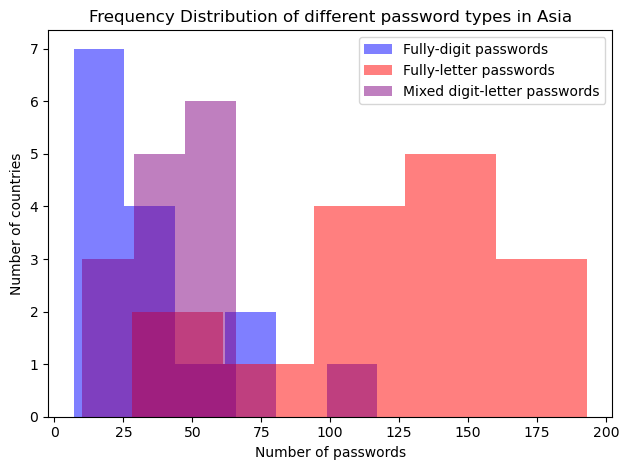

In [39]:
# see all 3 histograms in the same view for asia
# maybe change colors? it's hard to tell if the one between 100 & 125 dark is blue or purple
plt.hist(password_type_dist[(password_type_dist["password_type"]=="digits") & (password_type_dist["region"]=="Asia")].groupby("country").size(), bins=calculate_bins_fd(password_type_dist[(password_type_dist["password_type"]=="digits") & (password_type_dist["region"]=="Asia")].groupby("country").size()), alpha=0.5, label='Fully-digit passwords', color='blue')
plt.hist(password_type_dist[(password_type_dist["password_type"]=="chars") & (password_type_dist["region"]=="Asia")].groupby("country").size(), bins=calculate_bins_fd(password_type_dist[(password_type_dist["password_type"]=="chars") & (password_type_dist["region"]=="Asia")].groupby("country").size()), alpha=0.5, label='Fully-letter passwords', color='red')
plt.hist(password_type_dist[(password_type_dist["password_type"]=="combo") & (password_type_dist["region"]=="Asia")].groupby("country").size(), bins=calculate_bins_fd(password_type_dist[(password_type_dist["password_type"]=="combo") & (password_type_dist["region"]=="Asia")].groupby("country").size()), alpha=0.5, label='Mixed digit-letter passwords', color='purple')
plt.title('Frequency Distribution of different password types in Asia')
plt.xlabel('Number of passwords')
plt.ylabel('Number of countries')
plt.legend()
plt.tight_layout()
plt.savefig("histogram-diff-types-flexible-bins-asia.png",dpi=300,transparent=True)

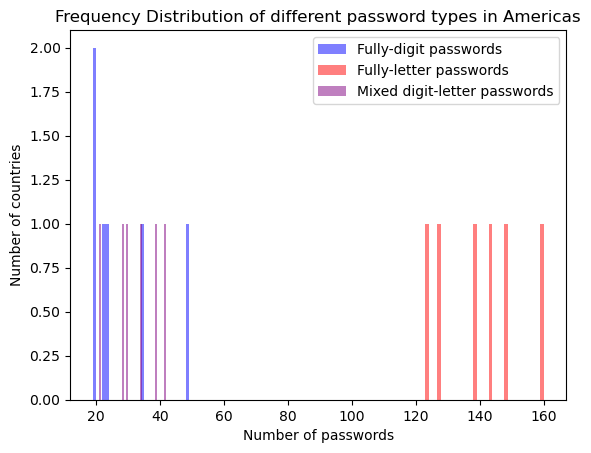

In [40]:
# see all 3 histograms in the same view for americas
plt.hist(password_type_dist[(password_type_dist["password_type"]=="digits") & (password_type_dist["region"]=="Americas")].groupby("country").size(), bins=30, alpha=0.5, label='Fully-digit passwords', color='blue')
plt.hist(password_type_dist[(password_type_dist["password_type"]=="chars") & (password_type_dist["region"]=="Americas")].groupby("country").size(), bins=30, alpha=0.5, label='Fully-letter passwords', color='red')
plt.hist(password_type_dist[(password_type_dist["password_type"]=="combo") & (password_type_dist["region"]=="Americas")].groupby("country").size(), bins=30, alpha=0.5, label='Mixed digit-letter passwords', color='purple')
plt.title('Frequency Distribution of different password types in Americas')
plt.xlabel('Number of passwords')
plt.ylabel('Number of countries')
plt.legend()

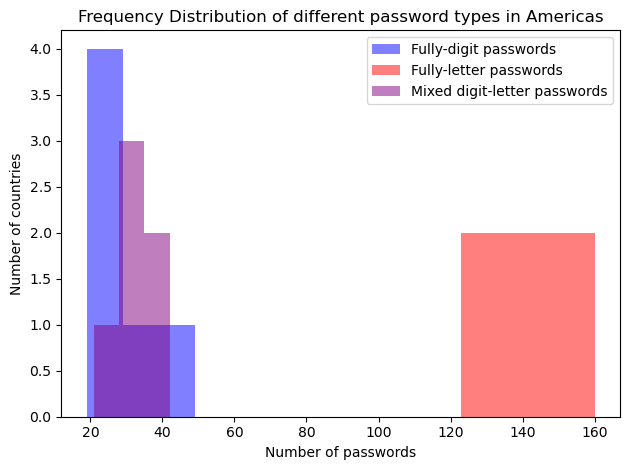

In [41]:
# see all 3 histograms in the same view for americas
plt.hist(password_type_dist[(password_type_dist["password_type"]=="digits") & (password_type_dist["region"]=="Americas")].groupby("country").size(), bins=calculate_bins_fd(password_type_dist[(password_type_dist["password_type"]=="digits") & (password_type_dist["region"]=="Americas")].groupby("country").size()), alpha=0.5, label='Fully-digit passwords', color='blue')
plt.hist(password_type_dist[(password_type_dist["password_type"]=="chars") & (password_type_dist["region"]=="Americas")].groupby("country").size(), bins=calculate_bins_fd(password_type_dist[(password_type_dist["password_type"]=="chars") & (password_type_dist["region"]=="Americas")].groupby("country").size()), alpha=0.5, label='Fully-letter passwords', color='red')
plt.hist(password_type_dist[(password_type_dist["password_type"]=="combo") & (password_type_dist["region"]=="Americas")].groupby("country").size(), bins=calculate_bins_fd(password_type_dist[(password_type_dist["password_type"]=="combo") & (password_type_dist["region"]=="Americas")].groupby("country").size()), alpha=0.5, label='Mixed digit-letter passwords', color='purple')
plt.title('Frequency Distribution of different password types in Americas')
plt.xlabel('Number of passwords')
plt.ylabel('Number of countries')
plt.legend()
plt.tight_layout()
plt.savefig("histogram-diff-types-flexible-bins-americas.png",dpi=300,transparent=True)

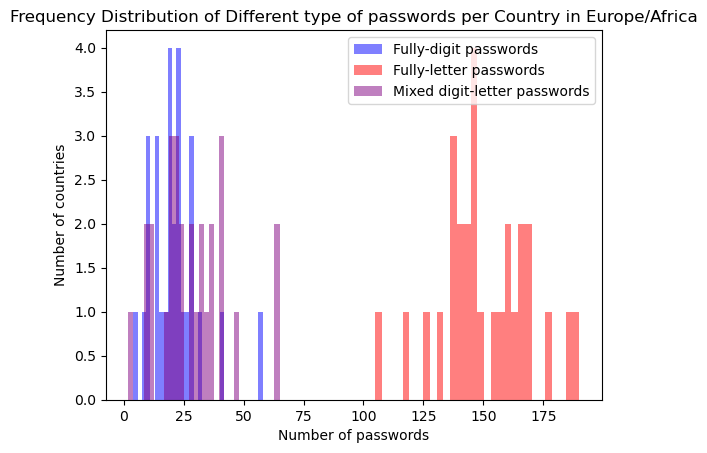

In [42]:
# see all 3 histograms in the same view for emea
plt.hist(password_type_dist[(password_type_dist["password_type"]=="digits") & (password_type_dist["region"]=="Europe/Africa")].groupby("country").size(), bins=30, alpha=0.5, label='Fully-digit passwords', color='blue')
plt.hist(password_type_dist[(password_type_dist["password_type"]=="chars") & (password_type_dist["region"]=="Europe/Africa")].groupby("country").size(), bins=30, alpha=0.5, label='Fully-letter passwords', color='red')
plt.hist(password_type_dist[(password_type_dist["password_type"]=="combo") & (password_type_dist["region"]=="Europe/Africa")].groupby("country").size(), bins=30, alpha=0.5, label='Mixed digit-letter passwords', color='purple')
plt.title('Frequency Distribution of Different type of passwords per Country in Europe/Africa')
plt.xlabel('Number of passwords')
plt.ylabel('Number of countries')
plt.legend()

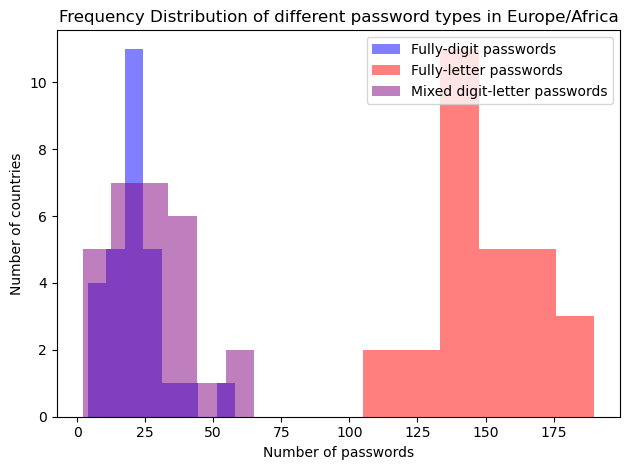

In [43]:
# see all 3 histograms in the same view for emea
plt.hist(password_type_dist[(password_type_dist["password_type"]=="digits") & (password_type_dist["region"]=="Europe/Africa")].groupby("country").size(), bins=calculate_bins_fd(password_type_dist[(password_type_dist["password_type"]=="digits") & (password_type_dist["region"]=="Europe/Africa")].groupby("country").size()), alpha=0.5, label='Fully-digit passwords', color='blue')
plt.hist(password_type_dist[(password_type_dist["password_type"]=="chars") & (password_type_dist["region"]=="Europe/Africa")].groupby("country").size(), bins=calculate_bins_fd(password_type_dist[(password_type_dist["password_type"]=="chars") & (password_type_dist["region"]=="Europe/Africa")].groupby("country").size()), alpha=0.5, label='Fully-letter passwords', color='red')
plt.hist(password_type_dist[(password_type_dist["password_type"]=="combo") & (password_type_dist["region"]=="Europe/Africa")].groupby("country").size(), bins=calculate_bins_fd(password_type_dist[(password_type_dist["password_type"]=="combo") & (password_type_dist["region"]=="Europe/Africa")].groupby("country").size()), alpha=0.5, label='Mixed digit-letter passwords', color='purple')
plt.title('Frequency Distribution of different password types in Europe/Africa')
plt.xlabel('Number of passwords')
plt.ylabel('Number of countries')
plt.legend()
plt.tight_layout()
plt.savefig("histogram-diff-types-flexible-bins-emea.png",dpi=300,transparent=True)

In [44]:
unique_countries_list

0                  Australia
200                  Austria
400                  Belgium
600                   Brazil
800                   Canada
1000                   Chile
1200                   China
1400                Colombia
1600          Czech Republic
1800                 Denmark
2000                 Estonia
2200                 Finland
2400                  France
2600                 Germany
2800                  Greece
3000                 Hungary
3200                   India
3400               Indonesia
3600                 Ireland
3800                  Israel
4000                   Italy
4200                   Japan
4400                   Korea
4600                  Latvia
4800               Lithuania
5000                Malaysia
5200                  Mexico
5400             Netherlands
5600             New Zealand
5800                 Nigeria
6000                  Norway
6200             Philippines
6400                  Poland
6600                Portugal
6800          

In [45]:
password_type_count_table = pd.DataFrame()
password_type_count_table["country"] = unique_countries_list
digits = []
chars = []
combo = []
regions = []
for country in password_type_count_table["country"]:
    digits.append(password_type_dist[(password_type_dist["password_type"]=="digits") & (password_type_dist["country"]==country)].shape[0])
    chars.append(password_type_dist[(password_type_dist["password_type"]=="chars") & (password_type_dist["country"]==country)].shape[0])
    combo.append(password_type_dist[(password_type_dist["password_type"]=="combo") & (password_type_dist["country"]==country)].shape[0])
    if country in americas_countries:
        regions.append("Americas")
    elif country in europe_and_africa_countries:
        regions.append("Europe/Africa")
    elif country in asia_and_middle_east_countries:
        regions.append("Asia")
    else:
        regions.append("not found")
        print("not found for {}".format(country))
password_type_count_table["region"] = regions
password_type_count_table["digits"] = digits
password_type_count_table["chars"] = chars
password_type_count_table["combo"] = combo

password_type_count_table_asia = password_type_count_table[password_type_count_table["region"]=="Asia"]

In [46]:
password_type_count_table

,country,region,digits,chars,combo
0,Australia,Asia,14,139,47
200,Austria,Europe/Africa,26,150,24
400,Belgium,Europe/Africa,19,163,18
600,Brazil,Americas,49,123,28
800,Canada,Americas,23,143,34
1000,Chile,Americas,22,148,30
1200,China,Asia,80,59,61
1400,Colombia,Americas,34,127,39
1600,Czech Republic,Europe/Africa,23,155,22
1800,Denmark,Europe/Africa,29,141,30


In [47]:
password_type_count_table = password_type_dist.groupby(["country", "password_type", "region"]).count().reset_index()

password_type_count_table_filter = password_type_count_table[["country", "password_type", "region", "Password"]]

asia = password_type_count_table_filter[password_type_count_table_filter["region"]=="Asia"]
asia

,country,password_type,region,Password
0,Australia,chars,Asia,139
1,Australia,combo,Asia,47
2,Australia,digits,Asia,14
18,China,chars,Asia,59
19,China,combo,Asia,61
20,China,digits,Asia,80
48,India,chars,Asia,148
49,India,combo,Asia,37
50,India,digits,Asia,15
51,Indonesia,chars,Asia,133


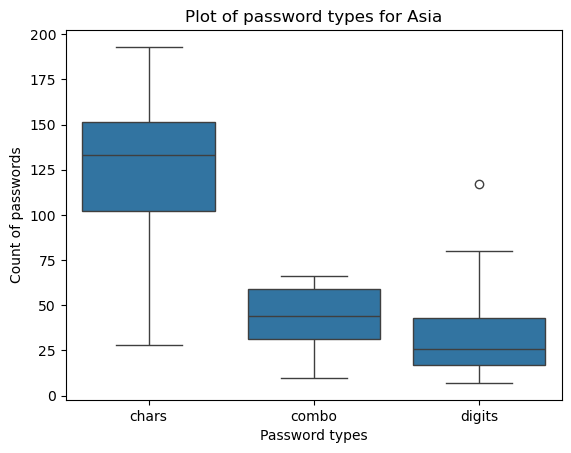

In [48]:
sns.boxplot(x='password_type', y='Password', data=asia)

# Add title and labels
plt.title('Plot of password types for Asia')
plt.xlabel('Password types')
plt.ylabel('Count of passwords')

# Show the plot
plt.savefig("box-plot-psswd-types-asia.png",dpi=300,transparent=True)
plt.show()

In [49]:
asia[asia["password_type"]=="chars"].describe()

,Password
count,15.000000
mean,124.600000
std,45.031418
min,28.000000
25%,102.000000
50%,133.000000
75%,151.500000
max,193.000000


In [50]:
asia[asia["password_type"]=="digits"].describe()

,Password
count,15.000000
mean,35.800000
std,30.350806
min,7.000000
25%,17.000000
50%,26.000000
75%,43.000000
max,117.000000


In [51]:
asia[asia["password_type"]=="combo"].describe()

,Password
count,14.000000
mean,42.428571
std,17.883014
min,10.000000
25%,31.250000
50%,44.000000
75%,58.750000
max,66.000000


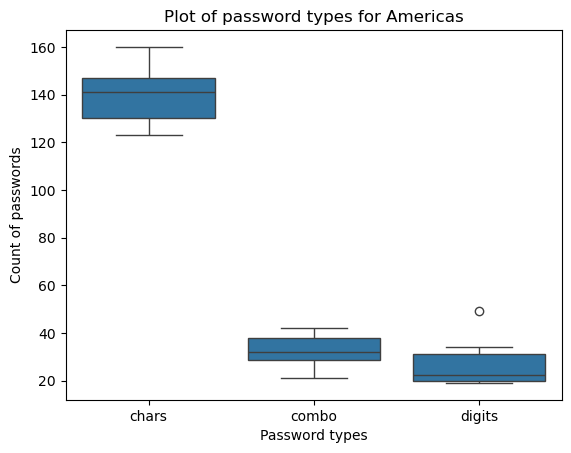

In [52]:
americas = password_type_count_table_filter[password_type_count_table_filter["region"]=="Americas"]
sns.boxplot(x='password_type', y='Password', data=americas)

# Add title and labels
plt.title('Plot of password types for Americas')
plt.xlabel('Password types')
plt.ylabel('Count of passwords')

# Show the plot
plt.savefig("box-plot-psswd-types-americas.png",dpi=300,transparent=True)
plt.show()

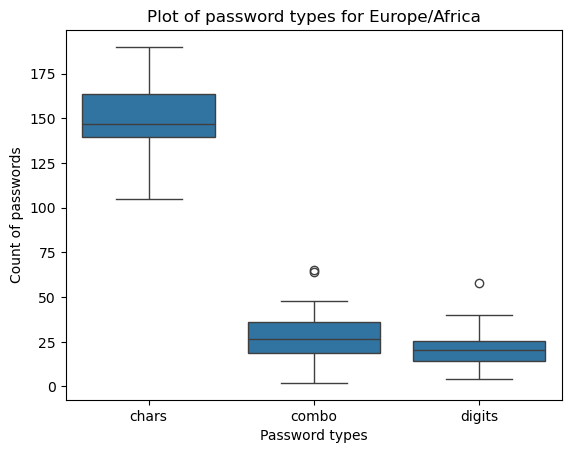

In [53]:
emea = password_type_count_table_filter[password_type_count_table_filter["region"]=="Europe/Africa"]
sns.boxplot(x='password_type', y='Password', data=emea)

# Add title and labels
plt.title('Plot of password types for Europe/Africa')
plt.xlabel('Password types')
plt.ylabel('Count of passwords')

# Show the plot
plt.savefig("box-plot-psswd-types-emea.png",dpi=300,transparent=True)
plt.show()

In [54]:
df_countries.nunique()

country_code                  49
country                       49
Rank                         200
Password                    4255
User_count                  7085
Time_to_crack                114
Global_rank                  185
Time_to_crack_in_seconds     106
unique_password                2
region                         3
password_type                  3
dtype: int64

In [55]:
user_count_table = df_countries[["country","password_type","User_count","region"]]
user_count_table

,country,password_type,User_count,region
0,Australia,digits,308483,Asia
1,Australia,chars,191880,Asia
2,Australia,chars,98220,Asia
3,Australia,combo,86884,Asia
4,Australia,digits,75856,Asia
...,...,...,...,...
9795,Vietnam,chars,2660,Asia
9796,Vietnam,chars,2628,Asia
9797,Vietnam,chars,2620,Asia
9798,Vietnam,chars,2584,Asia


In [56]:
user_count_per_password_type_table = user_count_table.groupby(["country", "password_type", "region"]).sum().reset_index()
user_count_per_password_type_table

asia_users = user_count_per_password_type_table[user_count_per_password_type_table["region"]=="Asia"]
asia_users

,country,password_type,region,User_count
0,Australia,chars,Asia,1822192
1,Australia,combo,Asia,596169
2,Australia,digits,Asia,664980
18,China,chars,Asia,1466700
19,China,combo,Asia,933041
20,China,digits,Asia,12339942
48,India,chars,Asia,4004198
49,India,combo,Asia,842396
50,India,digits,Asia,3339655
51,Indonesia,chars,Asia,1216240


In [57]:
asia_users["User_count"] = asia_users["User_count"]/1000

/var/folders/p1/w5y_34h54zs0lbj2lbcn6nt80000gn/T/ipykernel_51386/2486862459.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  asia_users["User_count"] = asia_users["User_count"]/1000


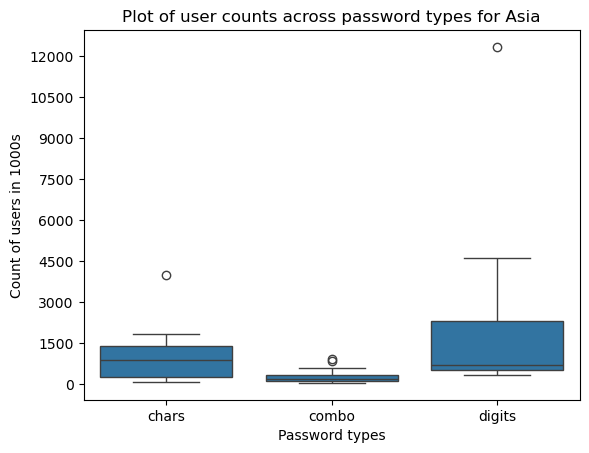

In [58]:
from matplotlib.ticker import ScalarFormatter
from matplotlib.ticker import MaxNLocator
sns.boxplot(x='password_type', y='User_count', data=asia_users)

plt.title('Plot of user counts across password types for Asia')
plt.xlabel('Password types')
plt.ylabel('Count of users in 1000s')
# plt.gca().yaxis.set_major_formatter(ScalarFormatter())
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True, prune='lower'))
plt.ticklabel_format(style='plain', axis='y') 

# Show the plot
plt.savefig("box-plot-users-asia.png",dpi=300,transparent=True)
plt.show()

In [59]:
asia_users[asia_users["password_type"]=="digits"].describe()

,User_count
count,15.000000
mean,2128.603867
std,3102.435720
min,331.223000
25%,508.161500
50%,698.138000
75%,2317.191000
max,12339.942000


/var/folders/p1/w5y_34h54zs0lbj2lbcn6nt80000gn/T/ipykernel_51386/4284613568.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  americas_users["User_count"] = americas_users["User_count"]/1000


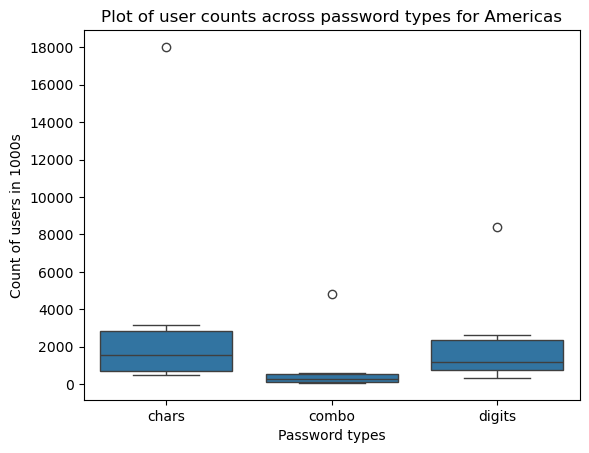

In [60]:
americas_users = user_count_per_password_type_table[user_count_per_password_type_table["region"]=="Americas"]

americas_users["User_count"] = americas_users["User_count"]/1000

sns.boxplot(x='password_type', y='User_count', data=americas_users)

plt.title('Plot of user counts across password types for Americas')
plt.xlabel('Password types')
plt.ylabel('Count of users in 1000s')
# plt.gca().yaxis.set_major_formatter(ScalarFormatter())
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True, prune='lower'))
plt.ticklabel_format(style='plain', axis='y') 

# Show the plot
plt.savefig("box-plot-users-americas.png",dpi=300,transparent=True)
plt.show()

/var/folders/p1/w5y_34h54zs0lbj2lbcn6nt80000gn/T/ipykernel_51386/3881575798.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  emea_users["User_count"] = emea_users["User_count"]/1000


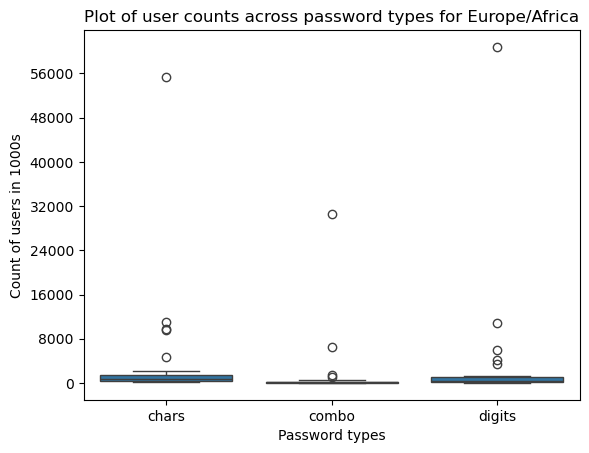

In [61]:
emea_users = user_count_per_password_type_table[user_count_per_password_type_table["region"]=="Europe/Africa"]

emea_users["User_count"] = emea_users["User_count"]/1000

sns.boxplot(x='password_type', y='User_count', data=emea_users)

plt.title('Plot of user counts across password types for Europe/Africa')
plt.xlabel('Password types')
plt.ylabel('Count of users in 1000s')
# plt.gca().yaxis.set_major_formatter(ScalarFormatter())
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True, prune='lower'))
plt.ticklabel_format(style='plain', axis='y') 

# Show the plot
plt.savefig("box-plot-users-emea.png",dpi=300,transparent=True)
plt.show()

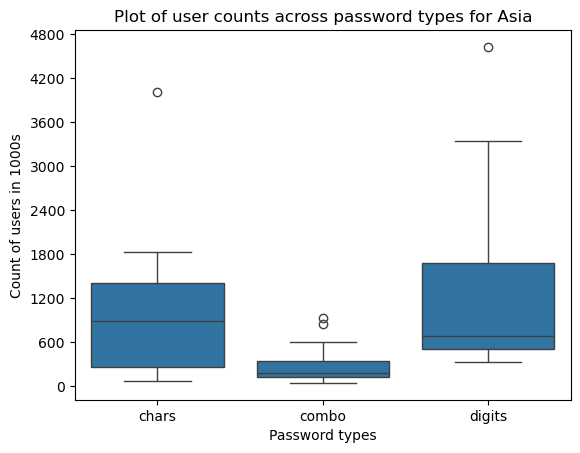

In [62]:
# remove some of the outliers across all 3 graphs - to see if visibility would increase
asia_users_filter = asia_users[asia_users["User_count"]<8000]

sns.boxplot(x='password_type', y='User_count', data=asia_users_filter)

plt.title('Plot of user counts across password types for Asia')
plt.xlabel('Password types')
plt.ylabel('Count of users in 1000s')
# plt.gca().yaxis.set_major_formatter(ScalarFormatter())
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True, prune='lower'))
plt.ticklabel_format(style='plain', axis='y') 

# Show the plot
plt.savefig("box-plot-users-asia-less-outliers.png",dpi=300,transparent=True)
plt.show()

In [63]:
blah = asia_users[asia_users["User_count"]<8000]
blah[asia_users["password_type"]=="chars"].describe()

/var/folders/p1/w5y_34h54zs0lbj2lbcn6nt80000gn/T/ipykernel_51386/2679398925.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  blah[asia_users["password_type"]=="chars"].describe()


,User_count
count,15.000000
mean,1021.500667
std,1010.973463
min,63.812000
25%,261.116500
50%,883.862000
75%,1401.120000
max,4004.198000


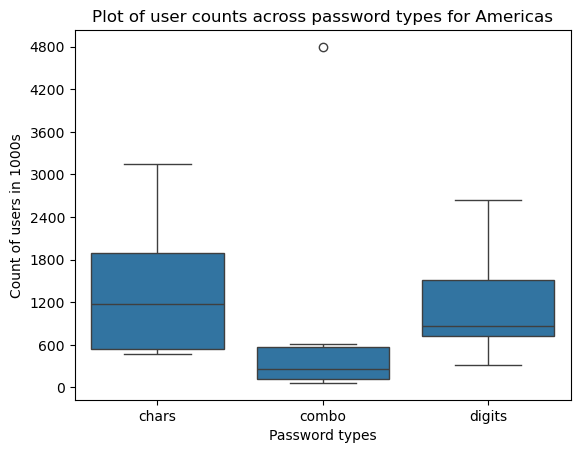

In [64]:
americas_users_filter = americas_users[americas_users["User_count"]<8000]

sns.boxplot(x='password_type', y='User_count', data=americas_users_filter)

plt.title('Plot of user counts across password types for Americas')
plt.xlabel('Password types')
plt.ylabel('Count of users in 1000s')
# plt.gca().yaxis.set_major_formatter(ScalarFormatter())
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True, prune='lower'))
plt.ticklabel_format(style='plain', axis='y') 

# Show the plot
plt.savefig("box-plot-users-americas-less-outliers.png",dpi=300,transparent=True)
plt.show()

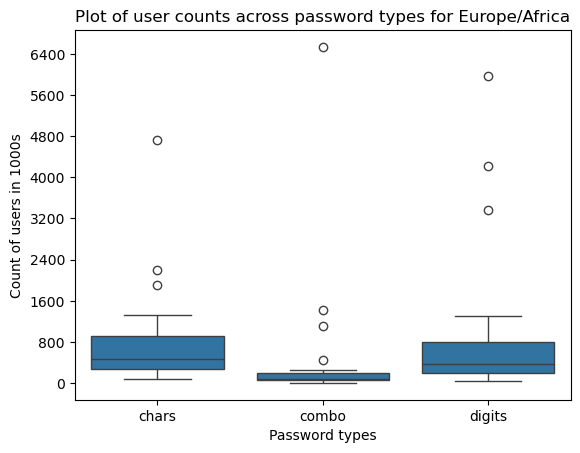

In [65]:
emea_users_filter = emea_users[emea_users["User_count"]<8000]

sns.boxplot(x='password_type', y='User_count', data=emea_users_filter)

plt.title('Plot of user counts across password types for Europe/Africa')
plt.xlabel('Password types')
plt.ylabel('Count of users in 1000s')
# plt.gca().yaxis.set_major_formatter(ScalarFormatter())
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True, prune='lower'))
plt.ticklabel_format(style='plain', axis='y') 

# Show the plot
plt.savefig("box-plot-users-emea-less-outliers.png",dpi=300,transparent=True)
plt.show()
# note: that removing the outliers will adjust the data (e.g., mean will end up being different) - misrepresentation
# instead I will adjust the y axis to not include the data past the 8000 mark which will keep the original box plot but make the
# plot more visible
# if remove data to change it def misrepresentation - but readjusting the y axis is disputable/discussion

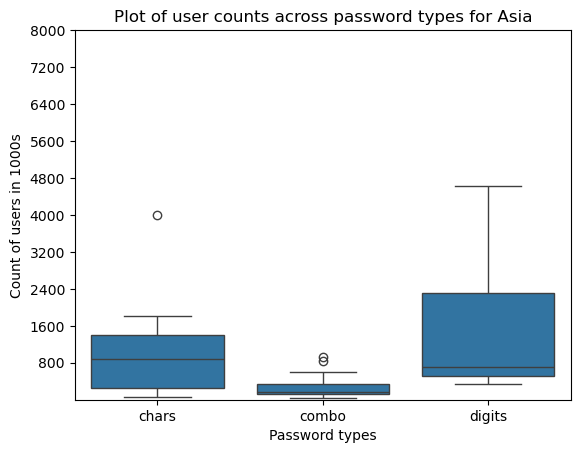

In [66]:
# instead trying to readjust the y axis on the initial one
sns.boxplot(x='password_type', y='User_count', data=asia_users)

plt.title('Plot of user counts across password types for Asia')
plt.xlabel('Password types')
plt.ylabel('Count of users in 1000s')
plt.ylim(0, 8000)
# plt.gca().yaxis.set_major_formatter(ScalarFormatter())
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True, prune='lower'))
plt.ticklabel_format(style='plain', axis='y') 

# Show the plot
plt.savefig("box-plot-users-asia-adjusted-axis-less-outliers.png",dpi=300,transparent=True)
plt.show()

In [67]:
asia_users[asia_users["password_type"]=="digits"].describe()

,User_count
count,15.000000
mean,2128.603867
std,3102.435720
min,331.223000
25%,508.161500
50%,698.138000
75%,2317.191000
max,12339.942000


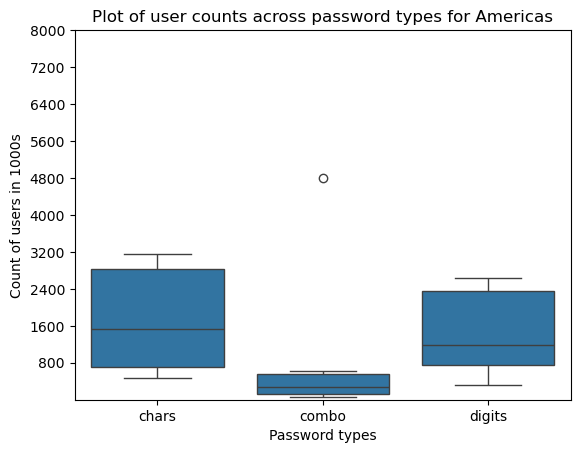

In [68]:
sns.boxplot(x='password_type', y='User_count', data=americas_users)

plt.title('Plot of user counts across password types for Americas')
plt.xlabel('Password types')
plt.ylabel('Count of users in 1000s')
plt.ylim(0, 8000)
# plt.gca().yaxis.set_major_formatter(ScalarFormatter())
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True, prune='lower'))
plt.ticklabel_format(style='plain', axis='y') 

# Show the plot
plt.savefig("box-plot-users-americas-adjusted-axis-less-outliers.png",dpi=300,transparent=True)
plt.show()

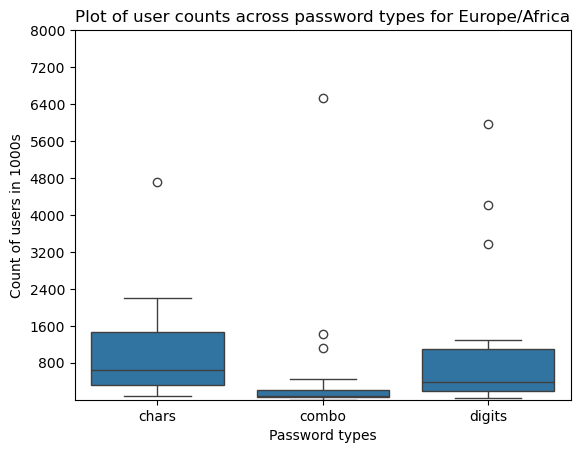

In [69]:
sns.boxplot(x='password_type', y='User_count', data=emea_users)

plt.title('Plot of user counts across password types for Europe/Africa')
plt.xlabel('Password types')
plt.ylabel('Count of users in 1000s')
plt.ylim(0, 8000)
# plt.gca().yaxis.set_major_formatter(ScalarFormatter())
plt.gca().yaxis.set_major_locator(MaxNLocator(integer=True, prune='lower'))
plt.ticklabel_format(style='plain', axis='y') 

# Show the plot
plt.savefig("box-plot-users-emea-adjusted-axis-less-outliers.png",dpi=300,transparent=True)
plt.show()

TIME TO CRACK

In [71]:
password_type_dist.groupby("country")["Time_to_crack_in_seconds"].mean()

country
Australia               5.976797e+04
Austria                 1.026148e+06
Belgium                 2.239815e+04
Brazil                  1.613735e+07
Canada                  4.998296e+06
Chile                   7.088719e+06
China                   1.050397e+05
Colombia                5.717405e+05
Czech Republic          8.119792e+04
Denmark                 4.897201e+05
Estonia                 7.296645e+04
Finland                 2.444704e+04
France                  6.742391e+04
Germany                 5.426753e+05
Greece                  8.114022e+05
Hungary                 3.819540e+03
India                   1.105793e+06
Indonesia               4.351774e+07
Ireland                 2.662440e+03
Israel                  1.012401e+04
Italy                   9.420367e+04
Japan                   8.406075e+03
Korea                   9.498750e+02
Latvia                  2.364351e+04
Lithuania               1.256489e+05
Malaysia                8.881785e+03
Mexico                  4.9779

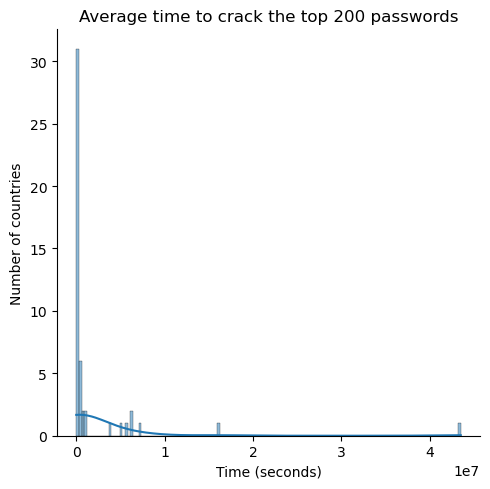

In [72]:
# relative frequency distributions
# time_to_crack_in_seconds - histogram
sns.displot(password_type_dist.groupby("country")["Time_to_crack_in_seconds"].mean(), kde=True)
plt.title('Average time to crack the top 200 passwords')
plt.xlabel('Time (seconds)')
plt.ylabel('Number of countries')
plt.tight_layout()
plt.savefig("time-to-crack-average.png",dpi=300,transparent=True)

plt.show()

In [73]:
password_type_dist.groupby("country")["Time_to_crack_in_seconds"].mean().describe()

count    4.900000e+01
mean     2.082684e+06
std      6.688847e+06
min      7.596750e+02
25%      1.012401e+04
50%      8.119792e+04
75%      5.717405e+05
max      4.351774e+07
Name: Time_to_crack_in_seconds, dtype: float64

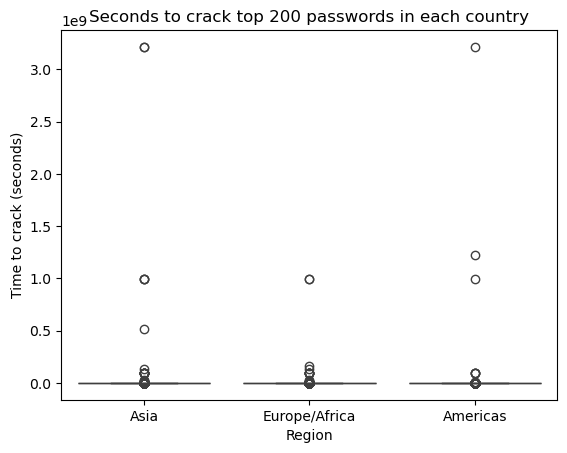

In [74]:
i = 0
# fig, axes = plt.subplots(1, 2, figsize=(12, 6))
# for region in password_type_dist["region"].unique():
sns.boxplot(x='region', y='Time_to_crack_in_seconds', data=password_type_dist)
# axes[i].set_title('North America')
# axes[i].set_xlabel('Country')
# axes[i].set_ylabel('Time to Crack (Seconds)')

# Add title and labels
plt.title('Seconds to crack top 200 passwords in each country')
plt.xlabel('Region')
plt.ylabel('Time to crack (seconds)')
plt.savefig("time-to-crack-box-plot.png",dpi=300,transparent=True)

# Show the plot
plt.show()

In [75]:
password_type_dist[password_type_dist["country"]=="Portugal"]

,country,Password,region,password_type,Time_to_crack_in_seconds
6600,Portugal,12345,Europe/Africa,digits,0
6601,Portugal,123456,Europe/Africa,digits,0
6602,Portugal,123456789,Europe/Africa,digits,0
6603,Portugal,12345678,Europe/Africa,digits,0
6604,Portugal,benfica,Europe/Africa,chars,0
...,...,...,...,...,...
6795,Portugal,akberbilal,Europe/Africa,chars,1036800
6796,Portugal,clayburnclark,Europe/Africa,chars,996364800
6797,Portugal,cherbill,Europe/Africa,chars,10800
6798,Portugal,natalia,Europe/Africa,chars,120


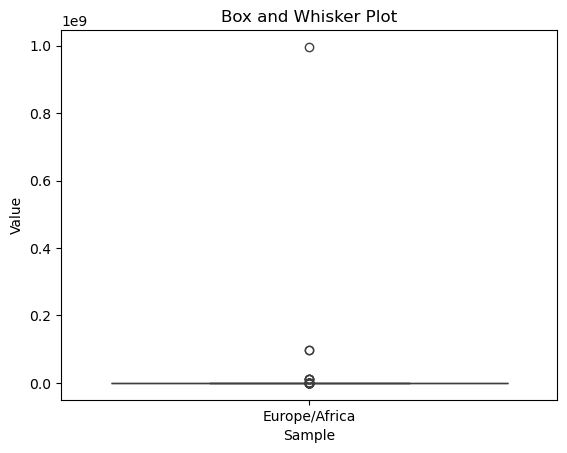

In [76]:
i = 0
# fig, axes = plt.subplots(1, 2, figsize=(12, 6))
# for region in password_type_dist["region"].unique():
sns.boxplot(x='region', y='Time_to_crack_in_seconds', data=password_type_dist[password_type_dist["country"]=="Portugal"])
# axes[i].set_title('North America')
# axes[i].set_xlabel('Country')
# axes[i].set_ylabel('Time to Crack (Seconds)')

# Add title and labels
plt.title('Box and Whisker Plot')
plt.xlabel('Sample')
plt.ylabel('Value')

# Show the plot
plt.show()
# because of the type of data box and whisker are useless, but removing the outliers might be a way to go
# extreme outliers impacting visualization and analysis attempts

In [77]:
df_countries[df_countries["country"]=="Portugal"].sort_values(by="Time_to_crack_in_seconds").tail(20)
# the 3 word type password?
# are these maybe also related to the name of the people using the passwords? cause if yes, the time_to_crack is incorrect
# if have insight into the person whose password you're cracking

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type
6764,pt,Portugal,165,nouhailalalala,3104,22 Hours,NaN,79200,False,Europe/Africa,chars
6632,pt,Portugal,33,deusefiel,9122,1 Day,NaN,86400,False,Europe/Africa,chars
6625,pt,Portugal,26,guilherme,10356,1 Day,NaN,86400,False,Europe/Africa,chars
6712,pt,Portugal,113,borboleta,4535,1 Day,NaN,86400,True,Europe/Africa,chars
6714,pt,Portugal,115,joaopedro,4481,1 Day,NaN,86400,True,Europe/Africa,chars
6620,pt,Portugal,21,margarida,11119,1 Day,NaN,86400,True,Europe/Africa,chars
6786,pt,Portugal,187,maricielo,2920,1 Day,NaN,86400,False,Europe/Africa,chars
6666,pt,Portugal,67,maripelos,6756,1 Day,NaN,86400,False,Europe/Africa,chars
6660,pt,Portugal,61,auliamoza,6875,1 Day,NaN,86400,False,Europe/Africa,chars
6654,pt,Portugal,55,felicidade,7043,12 Days,NaN,1036800,False,Europe/Africa,chars


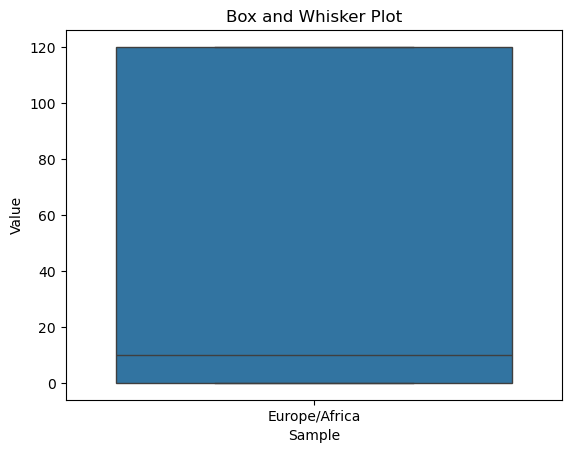

In [78]:
i = 0
# fig, axes = plt.subplots(1, 2, figsize=(12, 6))
# for region in password_type_dist["region"].unique():
sns.boxplot(x='region', y='Time_to_crack_in_seconds', data=password_type_dist[(password_type_dist["country"]=="Portugal") & (password_type_dist["Time_to_crack_in_seconds"]<200)])
# axes[i].set_title('North America')
# axes[i].set_xlabel('Country')
# axes[i].set_ylabel('Time to Crack (Seconds)')

# Add title and labels
plt.title('Box and Whisker Plot')
plt.xlabel('Sample')
plt.ylabel('Value')

# Show the plot
plt.show()
# because of the type of data box and whisker are useless, but removing the outliers might be a way to go
# extreme outliers impacting visualization and analysis attempts

# making box and whiskers work for this dataset invovled removing too mch of the data to the point where everything would be an outlier

# no information can be easily gathered from th box and whisker plots for this dataset
# would have to remove x% of data to make them look like good plots
# look at the descriptive stats to infer same

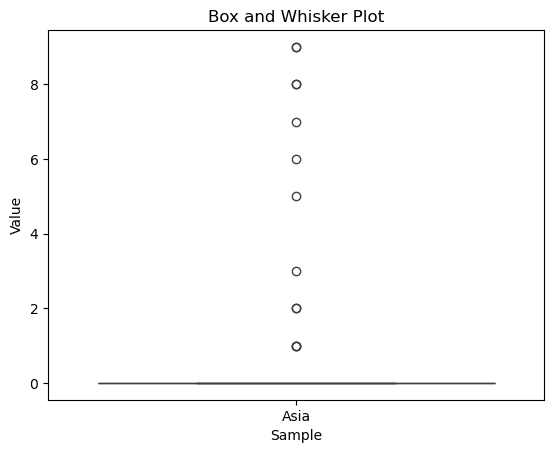

In [79]:
i = 0
# fig, axes = plt.subplots(1, 2, figsize=(12, 6))
# for region in password_type_dist["region"].unique():
sns.boxplot(x='region', y='Time_to_crack_in_seconds', data=password_type_dist[(password_type_dist["country"]=="Australia") & (password_type_dist["Time_to_crack_in_seconds"]<10)])
# axes[i].set_title('North America')
# axes[i].set_xlabel('Country')
# axes[i].set_ylabel('Time to Crack (Seconds)')

# Add title and labels
plt.title('Box and Whisker Plot')
plt.xlabel('Sample')
plt.ylabel('Value')

# Show the plot
plt.show()
# because of the type of data box and whisker are useless, but removing the outliers might be a way to go
# extreme outliers impacting visualization and analysis attempts

# making box and whiskers work for this dataset invovled removing too mch of the data to the point where everything would be an outlier

# no information can be easily gathered from th box and whisker plots for this dataset
# would have to remove x% of data to make them look like good plots
# look at the descriptive stats to infer same

# e.g., israel q1, q2, q3 are all 0 - do better!

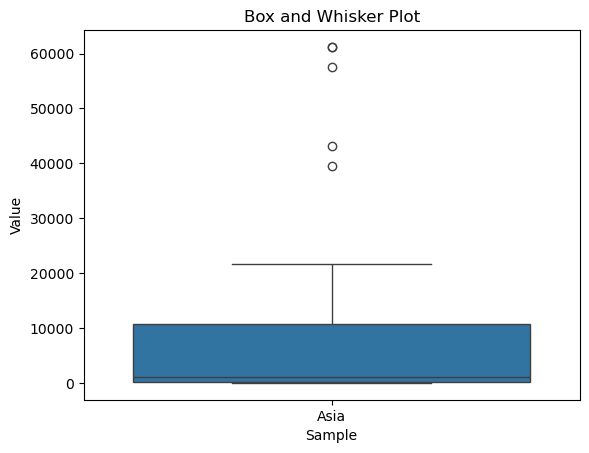

In [80]:
i = 0
# fig, axes = plt.subplots(1, 2, figsize=(12, 6))
# for region in password_type_dist["region"].unique():
sns.boxplot(x='region', y='Time_to_crack_in_seconds', data=password_type_dist[(password_type_dist["country"]=="Vietnam") & (password_type_dist["Time_to_crack_in_seconds"]<85000)])
# axes[i].set_title('North America')
# axes[i].set_xlabel('Country')
# axes[i].set_ylabel('Time to Crack (Seconds)')

# Add title and labels
plt.title('Box and Whisker Plot')
plt.xlabel('Sample')
plt.ylabel('Value')

# Show the plot
plt.show()
# because of the type of data box and whisker are useless, but removing the outliers might be a way to go
# extreme outliers impacting visualization and analysis attempts

# making box and whiskers work for this dataset invovled removing too mch of the data to the point where everything would be an outlier

# no information can be easily gathered from th box and whisker plots for this dataset
# would have to remove x% of data to make them look like good plots
# look at the descriptive stats to infer same

# e.g., israel q1, q2, q3 are all 0 - do better!

In [81]:
password_type_dist.groupby("country")["Time_to_crack_in_seconds"].describe()

,count,mean,std,min,25%,50%,75%,max
country,,,,,,,,
Australia,200.0,5.976797e+04,7.606869e+05,0.0,0.00,0.0,9.25,1.071360e+07
Austria,200.0,1.026148e+06,9.641790e+06,0.0,0.00,1.5,120.00,9.642240e+07
Belgium,200.0,2.239815e+04,1.315265e+05,0.0,0.00,4.0,1020.00,1.036800e+06
Brazil,200.0,1.613735e+07,2.272663e+08,0.0,0.00,5.0,1020.00,3.214080e+09
Canada,200.0,4.998296e+06,7.045257e+07,0.0,0.00,0.0,3.50,9.963648e+08
Chile,200.0,7.088719e+06,8.682692e+07,0.0,0.00,120.0,1020.00,1.221350e+09
China,200.0,1.050397e+05,3.287555e+05,0.0,0.00,2.0,1020.00,2.332800e+06
Colombia,200.0,5.717405e+05,6.855735e+06,0.0,0.00,0.0,120.00,9.642240e+07
Czech Republic,200.0,8.119792e+04,8.452228e+05,0.0,0.00,5.0,120.00,1.071360e+07


In [82]:
# treat this as continuous and do intervals
password_type_dist["Time_to_crack_in_seconds"].max()

3214080000

In [83]:
timedelta(seconds=password_type_dist["Time_to_crack_in_seconds"].max())

datetime.timedelta(days=37200)

In [84]:
password_type_dist["Time_to_crack_in_seconds"].min()

0

In [85]:
pd.options.display.float_format = '{:,.2f}'.format
password_type_dist.groupby("country")["Time_to_crack_in_seconds"].mean().sort_values()

country
United States                 759.67
Korea                         949.88
United Arab Emirates        1,515.82
Ireland                     2,662.44
South Africa                2,749.12
Hungary                     3,819.54
Sweden                      5,091.35
United Kingdom              6,120.43
Slovak Republic             7,275.03
Norway                      7,633.66
Japan                       8,406.08
Malaysia                    8,881.78
Israel                     10,124.01
Poland                     10,237.31
Belgium                    22,398.15
Latvia                     23,643.51
Finland                    24,447.04
Philippines                27,538.35
Romania                    34,072.51
Nigeria                    52,514.64
Australia                  59,767.97
France                     67,423.91
Estonia                    72,966.45
Ukraine                    75,958.79
Czech Republic             81,197.92
Switzerland                82,651.48
Italy                      94,

In [86]:
avg_time_crack_readabale = password_type_dist.groupby("country")["Time_to_crack_in_seconds"].mean().sort_values().apply(lambda seconds: str(pd.to_timedelta(seconds, unit='s')))
avg_time_crack_readabale
# 10 days onwards it's more effort already than it's worth - maybe good enough password practices

country
United States                0 days 00:12:39.675000
Korea                        0 days 00:15:49.875000
United Arab Emirates         0 days 00:25:15.820000
Ireland                      0 days 00:44:22.440000
South Africa                 0 days 00:45:49.120000
Hungary                      0 days 01:03:39.540000
Sweden                       0 days 01:24:51.345000
United Kingdom               0 days 01:42:00.430000
Slovak Republic              0 days 02:01:15.035000
Norway                       0 days 02:07:13.665000
Japan                        0 days 02:20:06.075000
Malaysia                     0 days 02:28:01.785000
Israel                       0 days 02:48:44.015000
Poland                       0 days 02:50:37.310000
Belgium                      0 days 06:13:18.150000
Latvia                       0 days 06:34:03.515000
Finland                      0 days 06:47:27.040000
Philippines                  0 days 07:38:58.355000
Romania                      0 days 09:27:52.510000
Nige

Text(0.5694444444444446, 0.5, 'Number of countries')

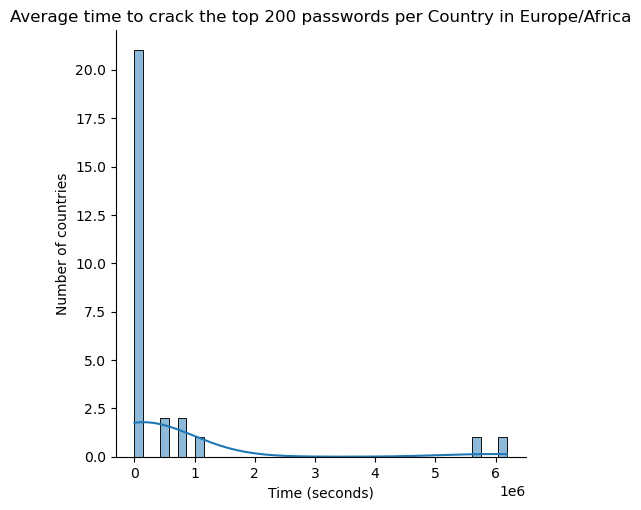

In [87]:
# in emea
sns.displot(password_type_dist[password_type_dist["region"]=="Europe/Africa"].groupby("country")["Time_to_crack_in_seconds"].mean(), kde=True)
plt.title('Average time to crack the top 200 passwords per Country in Europe/Africa')
plt.xlabel('Time (seconds)')
plt.ylabel('Number of countries')

In [88]:
password_type_dist[password_type_dist["region"]=="Europe/Africa"].groupby("country")["Time_to_crack_in_seconds"].mean().describe()

count          28.00
mean      587,271.95
std     1,536,573.40
min         2,662.44
25%         9,586.40
50%        70,195.18
75%       227,966.36
max     6,186,350.93
Name: Time_to_crack_in_seconds, dtype: float64

In [89]:
password_type_dist[password_type_dist["region"]=="Europe/Africa"].groupby("country")["Time_to_crack_in_seconds"].describe()

,count,mean,std,min,25%,50%,75%,max
country,,,,,,,,
Austria,200.00,"1,026,148.20","9,641,790.47",0.00,0.00,1.50,120.00,"96,422,400.00"
Belgium,200.00,"22,398.15","131,526.46",0.00,0.00,4.00,"1,020.00","1,036,800.00"
Czech Republic,200.00,"81,197.92","845,222.82",0.00,0.00,5.00,120.00,"10,713,600.00"
Denmark,200.00,"489,720.10","6,817,953.54",0.00,0.00,0.50,120.00,"96,422,400.00"
Estonia,200.00,"72,966.45","766,691.50",0.00,0.00,120.00,"1,020.00","10,713,600.00"
Finland,200.00,"24,447.04","145,630.66",0.00,0.00,120.00,"1,020.00","1,036,800.00"
France,200.00,"67,423.91","763,685.69",0.00,0.00,11.50,"1,020.00","10,713,600.00"
Germany,200.00,"542,675.26","6,856,113.79",0.00,0.00,0.00,45.75,"96,422,400.00"
Greece,200.00,"811,402.15","11,363,175.25",0.00,0.00,0.00,9.25,"160,704,000.00"


In [90]:
df_countries[df_countries["country"]=="Spain"].sort_values(by="Time_to_crack_in_seconds")
# the 3 word type password?
# are these maybe also related to the name of the people using the passwords? cause if yes, the time_to_crack is incorrect
# if have insight into the person whose password you're cracking - assumption that that is accurate since no more info

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type
7800,es,Spain,1,12345,966838,< 1 second,3.00,0,False,Europe/Africa,digits
7902,es,Spain,103,dragon,11956,< 1 second,38.00,0,False,Europe/Africa,chars
7900,es,Spain,101,12345678910,12486,< 1 second,113.00,0,False,Europe/Africa,digits
7896,es,Spain,97,aaaaaa,12972,< 1 second,53.00,0,False,Europe/Africa,chars
7892,es,Spain,93,159753,13241,< 1 second,44.00,0,False,Europe/Africa,digits
...,...,...,...,...,...,...,...,...,...,...,...
7911,es,Spain,112,tuputamadre,11067,4 Months,NaN,10713600,True,Europe/Africa,chars
7981,es,Spain,182,shyannmiles,6350,4 Months,NaN,10713600,False,Europe/Africa,chars
7983,es,Spain,184,gabinphilippeau,6337,6 Months,NaN,16070400,False,Europe/Africa,chars
7891,es,Spain,92,jobandtalent,13246,3 Years,NaN,96422400,False,Europe/Africa,chars


Text(13.819444444444445, 0.5, 'Number of countries')

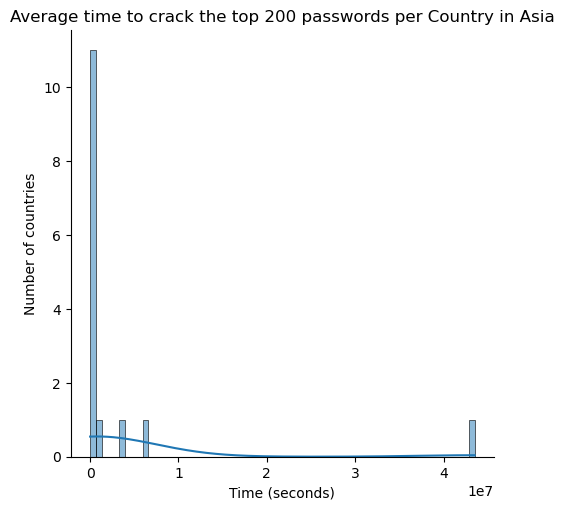

In [91]:
# in asia
sns.displot(password_type_dist[password_type_dist["region"]=="Asia"].groupby("country")["Time_to_crack_in_seconds"].mean(), kde=True)
plt.title('Average time to crack the top 200 passwords per Country in Asia')
plt.xlabel('Time (seconds)')
plt.ylabel('Number of countries')

In [92]:
password_type_dist[password_type_dist["region"]=="Asia"].groupby("country")["Time_to_crack_in_seconds"].mean().describe()

count           15.00
mean     3,754,217.83
std     11,145,319.44
min            949.88
25%          9,502.90
50%        105,039.74
75%        833,879.44
max     43,517,736.92
Name: Time_to_crack_in_seconds, dtype: float64

In [93]:
df_countries[df_countries["country"]=="Indonesia"].sort_values(by="Time_to_crack_in_seconds")
# the 3 word type password?

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type
3400,id,Indonesia,1,12345,548280,< 1 second,3.00,0,False,Asia,digits
3463,id,Indonesia,64,asd123,7853,< 1 second,80.00,0,False,Asia,combo
3462,id,Indonesia,63,1q2w3e,7995,< 1 second,13.00,0,False,Asia,combo
3539,id,Indonesia,140,asdasd,4636,< 1 second,35.00,0,False,Asia,chars
3460,id,Indonesia,61,master,8520,< 1 second,82.00,0,False,Asia,chars
...,...,...,...,...,...,...,...,...,...,...,...
3552,id,Indonesia,153,vinninaicker,4318,3 Years,NaN,96422400,False,Asia,chars
3528,id,Indonesia,129,pabloparraito,4830,31 Years,NaN,996364800,True,Asia,chars
3554,id,Indonesia,155,clayburnclark,4290,31 Years,NaN,996364800,False,Asia,chars
3495,id,Indonesia,96,kallynlavallee,5840,Centuries,NaN,3214080000,True,Asia,chars


Text(9.444444444444445, 0.5, 'Number of countries')

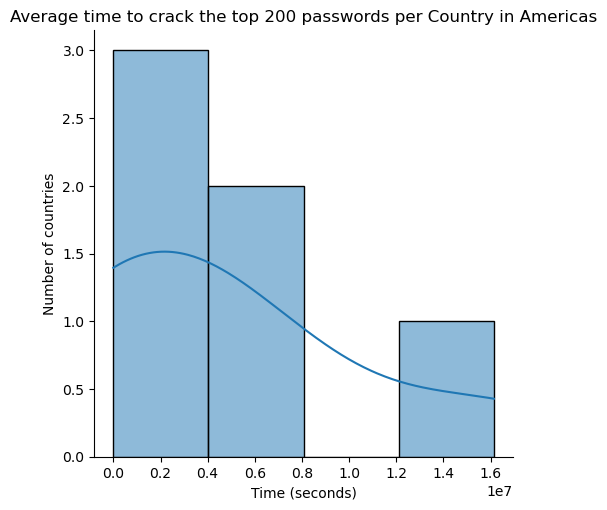

In [94]:
# in americas
sns.displot(password_type_dist[password_type_dist["region"]=="Americas"].groupby("country")["Time_to_crack_in_seconds"].mean(), kde=True)
plt.title('Average time to crack the top 200 passwords per Country in Americas')
plt.xlabel('Time (seconds)')
plt.ylabel('Number of countries')

In [95]:
password_type_dist[password_type_dist["region"]=="Americas"].groupby("country")["Time_to_crack_in_seconds"].mean().describe()

count            6.00
mean     4,882,442.00
std      6,215,980.85
min            759.67
25%        516,278.11
50%      2,785,018.29
75%      6,566,113.02
max     16,137,346.41
Name: Time_to_crack_in_seconds, dtype: float64

In [96]:
df_countries[df_countries["country"]=="Canada"].sort_values(by="Time_to_crack_in_seconds")
# the 3 word type password?
# are these maybe also related to the name of the people using the passwords? cause if yes, the time_to_crack is incorrect
# if have insight into the person whose password you're cracking

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type
800,ca,Canada,1,123456,570178,< 1 second,1.00,0,False,Americas,digits
919,ca,Canada,120,smokey,14540,< 1 second,NaN,0,False,Americas,chars
920,ca,Canada,121,batman,14533,< 1 second,NaN,0,False,Americas,chars
922,ca,Canada,123,121212,14402,< 1 second,34.00,0,False,Americas,digits
923,ca,Canada,124,chicken,14385,< 1 second,NaN,0,False,Americas,chars
...,...,...,...,...,...,...,...,...,...,...,...
976,ca,Canada,177,yuantuo2012,9999,1 Day,NaN,86400,False,Americas,combo
951,ca,Canada,152,goodday85S,11936,12 Days,NaN,1036800,False,Americas,combo
988,ca,Canada,189,Bajaonel12,8739,12 Days,NaN,1036800,False,Americas,combo
990,ca,Canada,191,1v7Upjw3nT,7956,12 Days,NaN,1036800,False,Americas,combo


In [97]:
df_countries[df_countries["Password"]=="1v7Upjw3nT"]
# why would this be used across 2 countries enough so in top 200 for both?
# doesn't seem to be simple obfuscation so a simple/memorable password...interesting

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type
990,ca,Canada,191,1v7Upjw3nT,7956,12 Days,NaN,1036800,False,Americas,combo
3467,id,Indonesia,68,1v7Upjw3nT,7601,12 Days,NaN,1036800,False,Asia,combo


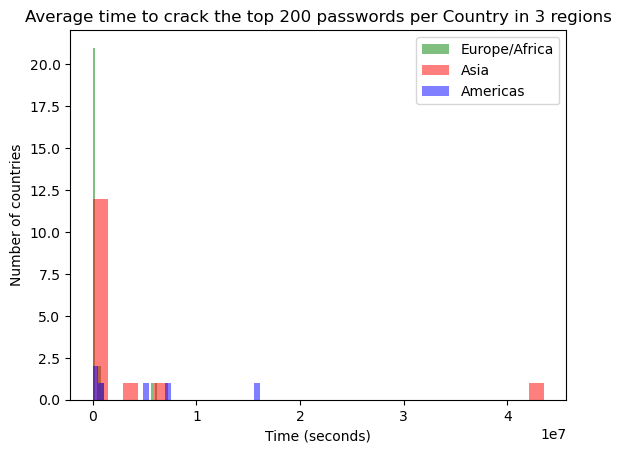

In [98]:
# see all 3 histograms in the same view
plt.hist(password_type_dist[password_type_dist["region"]=="Europe/Africa"].groupby("country")["Time_to_crack_in_seconds"].mean(), bins=30, alpha=0.5, label='Europe/Africa', color='green')
plt.hist(password_type_dist[password_type_dist["region"]=="Asia"].groupby("country")["Time_to_crack_in_seconds"].mean(), bins=30, alpha=0.5, label='Asia', color='red')
plt.hist(password_type_dist[password_type_dist["region"]=="Americas"].groupby("country")["Time_to_crack_in_seconds"].mean(), bins=30, alpha=0.5, label='Americas', color='blue')
plt.title('Average time to crack the top 200 passwords per Country in 3 regions')
plt.xlabel('Time (seconds)')
plt.ylabel('Number of countries')
plt.legend()

In [99]:
password_type_dist[password_type_dist["region"]=="Europe/Africa"].groupby("country")["Time_to_crack_in_seconds"].mean()

country
Austria           1,026,148.20
Belgium              22,398.15
Czech Republic       81,197.92
Denmark             489,720.10
Estonia              72,966.45
Finland              24,447.04
France               67,423.91
Germany             542,675.26
Greece              811,402.15
Hungary               3,819.54
Ireland               2,662.44
Italy                94,203.67
Latvia               23,643.51
Lithuania           125,648.90
Netherlands         767,603.59
Nigeria              52,514.64
Norway                7,633.66
Poland               10,237.31
Portugal          6,186,350.93
Romania              34,072.51
Russia              140,715.11
Slovak Republic       7,275.03
South Africa          2,749.12
Spain             5,676,283.41
Sweden                5,091.35
Switzerland          82,651.48
Ukraine              75,958.79
United Kingdom        6,120.43
Name: Time_to_crack_in_seconds, dtype: float64

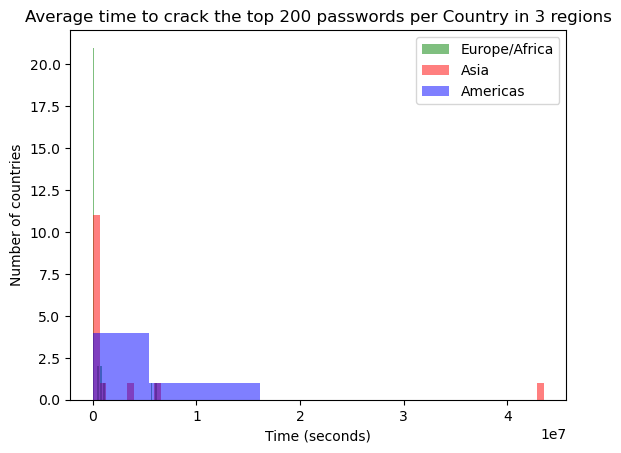

In [100]:
# see all 3 histograms in the same view
plt.hist(password_type_dist[password_type_dist["region"]=="Europe/Africa"].groupby("country")["Time_to_crack_in_seconds"].mean(), bins=calculate_bins_fd(password_type_dist[password_type_dist["region"]=="Europe/Africa"].groupby("country")["Time_to_crack_in_seconds"].mean()), alpha=0.5, label='Europe/Africa', color='green')
plt.hist(password_type_dist[password_type_dist["region"]=="Asia"].groupby("country")["Time_to_crack_in_seconds"].mean(), bins=calculate_bins_fd(password_type_dist[password_type_dist["region"]=="Asia"].groupby("country")["Time_to_crack_in_seconds"].mean()), alpha=0.5, label='Asia', color='red')
plt.hist(password_type_dist[password_type_dist["region"]=="Americas"].groupby("country")["Time_to_crack_in_seconds"].mean(), bins=calculate_bins_fd(password_type_dist[password_type_dist["region"]=="Americas"].groupby("country")["Time_to_crack_in_seconds"].mean()), alpha=0.5, label='Americas', color='blue')
plt.title('Average time to crack the top 200 passwords per Country in 3 regions')
plt.xlabel('Time (seconds)')
plt.ylabel('Number of countries')
plt.legend()

In [101]:
# number of users that fall within that low time to crack category - be at risk
# number of passwords that take 0 seconds
# number of passwords that would take at least 24h

In [102]:
# would be cool to look into the good practices already there

In [103]:
# can I tell among the countries that don't have good practices why?

In [104]:
# do a similar one with the strengths
# for the unique list of passwords - do the strength calculation and see how many that remain can go through the partial matchup 

In [105]:
# over x percent of countries have password overlap with other countries
# what regions are the countries from and what languages?

In [106]:
# relative frequency of passwords for each value take the sum of user_counts - get distribution world_wide
# maybe top 10/bottom 10

In [107]:
# so use webinar 2 slide 11 to split user_counts into intervals (since continuous) and do frequency per region -TBD

In [108]:
# HISTOGRAM ANALYSIS
# for the histograms we choose understand distributions and describe shape

In [109]:
# WEBINAR 3 - central tendency
# cannot get population mean - cause I have a sample of 200 passwords per country
# get sample mean, median, mode - time to crack and user_count (might be harder to find a mode for user_count)
df_countries.describe()
# how to change the numbers into non-scientific notations

,Rank,User_count,Global_rank,Time_to_crack_in_seconds
count,"9,800.00","9,800.00","3,172.00","9,800.00"
mean,100.50,"34,685.94",65.34,"2,082,684.37"
std,57.74,"365,934.04",53.41,"63,016,732.90"
min,1.00,126.00,1.00,0.00
25%,50.75,"1,642.75",22.00,0.00
50%,100.50,"3,948.00",50.00,2.00
75%,150.25,"11,517.50",101.50,360.00
max,200.00,"19,000,630.00",200.00,"3,214,080,000.00"


In [110]:
# WEBINAR 4 - MEASURES OF DISPERSION
# do all 3 for user_count per country? or region
# do all 3 for time_to_crack per country or region
# do all 3 for user_count and time_to_crack per password_type

Webinar 5 - Scatter plots and bivariate correlations

In [112]:
df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,digits
1,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,chars
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800,True,Asia,chars
3,au,Australia,4,password1,86884,< 1 second,16.00,0,False,Asia,combo
4,au,Australia,5,123456789,75856,< 1 second,2.00,0,False,Asia,digits
...,...,...,...,...,...,...,...,...,...,...,...
9795,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800,True,Asia,chars
9796,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020,True,Asia,chars
9797,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800,True,Asia,chars
9798,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200,True,Asia,chars


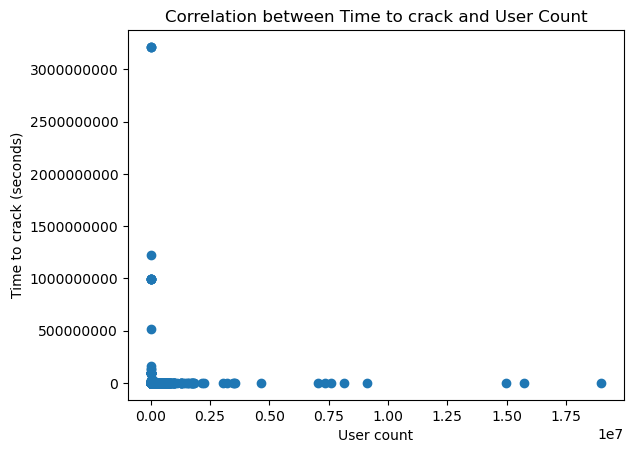

In [113]:
plt.scatter(df_countries["User_count"], df_countries["Time_to_crack_in_seconds"])

# Adding labels and title
plt.xlabel('User count')
plt.ylabel('Time to crack (seconds)')
plt.title('Correlation between Time to crack and User Count')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')

# Show the plot
plt.show()

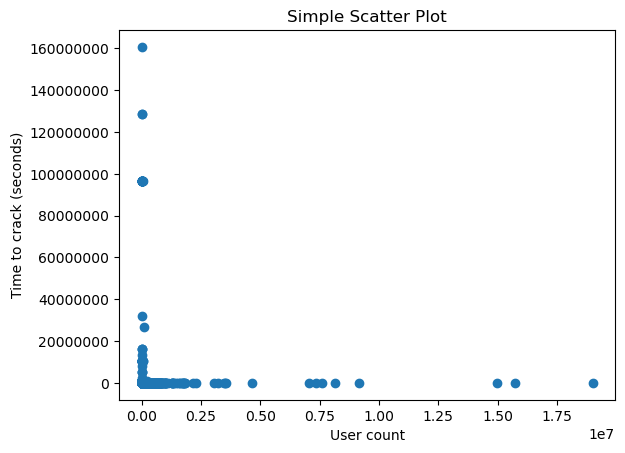

In [114]:
df_countries_remove_outliers = df_countries[df_countries["Time_to_crack_in_seconds"]<500000000]
plt.scatter(df_countries_remove_outliers["User_count"], df_countries_remove_outliers["Time_to_crack_in_seconds"])

# Adding labels and title
plt.xlabel('User count')
plt.ylabel('Time to crack (seconds)')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

In [115]:
# add new columns based on another data set to enrich the data with strength score of passwords
# strength score over time to crack
# strength score over user_count
# note that this dataset was chosen so it relates to the othre modules

In [116]:
# dropped some extra columns by hand cause couldn't read it in - they were all for the same password "simlan"?
df_strength = pd.read_csv('/Users/nina/data/password_strength.csv')
df_strength

,password,strength
0,kzde5577,1
1,kino3434,1
2,visi7k1yr,1
3,megzy123,1
4,lamborghin1,1
...,...,...
669635,10redtux10,1
669636,infrared1,1
669637,184520socram,1
669638,marken22a,1


In [117]:
df_strength = df_strength.drop_duplicates()

In [118]:
# other passwords have diff strengths for the same password - e.g., 123456 is both strength 0 and 1
# it makes sense to only keep the lowest strength
grouped = df_strength.groupby('password')['strength'].nunique()  # This gives the number of unique values in 'Y' for each 'X'
grouped

password
b)|        1

          1
xU]        1
           1
px          1
            ..
¹°´³¶25      1
ÄéÁ§Ç      1
ÅŸifre741    1
Ð½Ð°         1
Ó 
?Pæ|è     1
Name: strength, Length: 669506, dtype: int64

In [119]:
grouped["123456"]

2

In [120]:
df_lowest = df_strength.loc[df_strength.groupby('password')['strength'].idxmin()]
print(df_lowest)

         password  strength
491065      b)|         0
19541                  0
310552      xU]         0
105871                  0
436376        px         0
...           ...       ...
389567    ¹°´³¶25         0
586384    ÄéÁ§Ç         0
72467   ÅŸifre741         1
648475       Ð½Ð°         0
236659   Ó ?Pæ|è         1

[669506 rows x 2 columns]


In [121]:
df_lowest[df_lowest["password"]=="123456"]

,password,strength
355329,123456,0


In [122]:
# merge on perfect match
df_exact_match = pd.merge(df_countries, df_lowest, left_on="Password", right_on="password", how='inner')
df_exact_match

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type,password,strength
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,digits,123456,0
1,au,Australia,4,password1,86884,< 1 second,16.00,0,False,Asia,combo,password1,1
2,au,Australia,5,123456789,75856,< 1 second,2.00,0,False,Asia,digits,123456789,1
3,au,Australia,6,12345,69344,< 1 second,3.00,0,False,Asia,digits,12345,0
4,au,Australia,8,qwerty,67130,< 1 second,4.00,0,False,Asia,chars,qwerty,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1807,vn,Vietnam,2,123456789,993222,< 1 second,2.00,0,False,Asia,digits,123456789,1
1808,vn,Vietnam,4,1234567890,75409,< 1 second,9.00,0,False,Asia,digits,1234567890,1
1809,vn,Vietnam,8,1234567,27162,< 1 second,10.00,0,False,Asia,digits,1234567,1
1810,vn,Vietnam,10,123123,22037,< 1 second,8.00,0,False,Asia,digits,123123,0


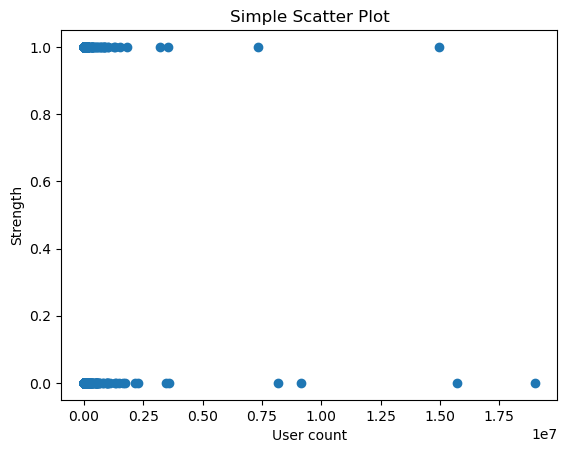

In [123]:
plt.scatter(df_exact_match["User_count"], df_exact_match["strength"])

# Adding labels and title
plt.xlabel('User count')
plt.ylabel('Strength')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

# doesn't make a lot of sense either cause strength is ordinate values (0 worse, weaker than 2)
# 0 for weak, 1 for medium, 2 for strong - https://www.kaggle.com/datasets/bhavikbb/password-strength-classifier-dataset

In [124]:
# another take at enrichment using another dataset on passwords - https://www.kaggle.com/datasets/karthikudyawar/password-metrics-dataset
import kagglehub
path = kagglehub.dataset_download("karthikudyawar/password-metrics-dataset")
path

'/Users/nina/.cache/kagglehub/datasets/karthikudyawar/password-metrics-dataset/versions/1'

In [125]:
# dropped some extra columns by hand cause couldn't read it in - they were all for the same password "simlan"?
df_strength = pd.read_csv('/Users/nina/.cache/kagglehub/datasets/karthikudyawar/password-metrics-dataset/versions/1/dataset.csv')
df_strength

,password,strength,length,class_strength,entropy,crack_time_sec,crack_time
0,bybee,0.09,5,Very week,11.61,0.00,instant
1,n3m0,0.09,4,Very week,8.00,0.00,instant
2,2509,0.09,4,Very week,8.00,0.00,instant
3,4622,0.07,4,Very week,8.00,0.00,instant
4,shrk,0.09,4,Very week,8.00,0.00,instant
...,...,...,...,...,...,...,...
99995,sifelizestasdecirmeloquerras,0.93,28,Very strong,134.61,"16,572,761,556,626,810,434,435,218,931,712.00",Eternity
99996,iwillalwayslovemyboyfriend,0.92,26,Very strong,122.21,"3,078,059,790,103,566,716,919,349,248.00",Eternity
99997,letsyouupdateyourfunNotesandmore,0.96,32,Very strong,160.00,"730,750,818,665,451,504,614,166,361,917,959,962...",Eternity
99998,chocolatesoeusi912134741,0.90,24,Very strong,110.04,"666,867,888,425,147,329,150,976.00",Eternity


In [126]:
# merge on perfect match
df_exact_match = pd.merge(df_countries, df_strength, left_on="Password", right_on="password", how='inner')
df_exact_match

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type,password,strength,length,class_strength,entropy,crack_time_sec,crack_time
0,fi,Finland,17,kakka,2583,10 Seconds,NaN,10,True,Europe/Africa,chars,kakka,0.06,5,Very week,11.61,0.00,instant
1,fi,Finland,17,kakka,2583,10 Seconds,NaN,10,True,Europe/Africa,chars,kakka,0.06,5,Very week,11.61,0.00,instant
2,fi,Finland,17,kakka,2583,10 Seconds,NaN,10,True,Europe/Africa,chars,kakka,0.06,5,Very week,11.61,0.00,instant
3,fi,Finland,17,kakka,2583,10 Seconds,NaN,10,True,Europe/Africa,chars,kakka,0.06,5,Very week,11.61,0.00,instant
4,fi,Finland,66,joonas,1033,2 Minutes,NaN,120,True,Europe/Africa,chars,joonas,0.15,6,Very week,15.51,0.00,instant
5,fi,Finland,66,joonas,1033,2 Minutes,NaN,120,True,Europe/Africa,chars,joonas,0.15,6,Very week,15.51,0.00,instant
6,fi,Finland,66,joonas,1033,2 Minutes,NaN,120,True,Europe/Africa,chars,joonas,0.15,6,Very week,15.51,0.00,instant
7,fi,Finland,66,joonas,1033,2 Minutes,NaN,120,True,Europe/Africa,chars,joonas,0.15,6,Very week,15.51,0.00,instant
8,de,Germany,182,kkkkkkk,27876,< 1 second,NaN,0,True,Europe/Africa,chars,kkkkkkk,0.00,7,Very week,19.65,0.00,instant
9,de,Germany,182,kkkkkkk,27876,< 1 second,NaN,0,True,Europe/Africa,chars,kkkkkkk,0.00,7,Very week,19.65,0.00,instant


In [127]:
path = kagglehub.dataset_download("harisellowpay/password-reset-dataset")

In [128]:
df_reset = pd.read_csv('/Users/nina/.cache/kagglehub/datasets/harisellowpay/password-reset-dataset/versions/1/synthetic_password_reset_data.csv')
df_reset

,Unnamed: 0,timestamp,action,event_type,location,ip,password,hour,time_difference,reset_count
0,2,2023-05-10 10:10:20,success,forgot_password,Garciafort,1.38.241.137,ww}ID-..Cc'm{]Mam<UwN,10,"-6,658,464.00",1
1,3,2023-04-15 03:16:18,success,update_password,Hendersonfurt,204.21.129.123,"8CDj,Y""dPmS#",3,"-2,184,842.00",1
2,4,2023-05-25 05:49:43,success,forgot_password,South Robert,172.49.235.138,~FrjBA.vffz=Zd*xk$Z2;9.2(,5,"3,465,205.00",1
3,5,2023-09-14 13:26:21,success,forgot_password,Leahmouth,65.167.248.173,"}9S#W3D,j+B-Izf5!qwj=V`6:qXR'^",13,"9,704,198.00",1
4,7,2023-08-16 13:16:14,success,update_password,Paigemouth,c6b6:276c:e973:a56d:f438:4970:a1c3:9b5e,&!Ae.3.dF&,13,"5,472,798.00",2
...,...,...,...,...,...,...,...,...,...,...
25069,49988,2023-06-15 03:06:17,failure,forgot_password,New Crystal,194.65.127.242,sailor,3,"-5,860,388.00",2092
25070,49990,2023-08-11 21:53:03,failure,update_password,West Carolyn,122.203.104.9,softball4,21,"9,857,874.00",2043
25071,49992,2023-09-02 05:30:40,failure,forgot_password,Lake Breanna,29.95.66.127,mayte,5,"5,725,480.00",2144
25072,49994,2023-10-02 10:57:58,failure,update_password,Anthonyburgh,99ba:7c42:3e39:994c:930d:7bc3:692d:7ec5,guayaquil,10,"12,384,715.00",2119


In [129]:
df_reset["password"].nunique()

10908

In [130]:
# merge on perfect match
df_exact_match = pd.merge(df_countries, df_reset, left_on="Password", right_on="password", how='inner')
df_exact_match

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,...,Unnamed: 0,timestamp,action,event_type,location,ip,password,hour,time_difference,reset_count
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,...,1344,2023-05-10 20:57:03,failure,update_password,Josephbury,4e71:76b6:54e9:34aa:586a:769b:e638:90b3,123456,20,"4,957,464.00",57
1,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,...,23206,2023-06-20 09:56:16,failure,update_password,New Erinhaven,178.253.197.110,123456,9,"8,225,277.00",995
2,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,...,34856,2023-09-03 04:35:18,failure,forgot_password,West Maryburgh,179.187.209.22,123456,4,"5,249,306.00",1406
3,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,...,2624,2023-06-12 23:37:05,failure,forgot_password,South Mistyfort,103.215.26.1,password,23,"10,360,682.00",104
4,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,...,10726,2023-08-10 17:17:14,failure,update_password,Williamstown,180.246.139.140,password,17,"8,705,460.00",439
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13634,vn,Vietnam,149,shinichi,3303,3 Hours,NaN,10800,True,Asia,...,31277,2023-01-29 00:47:57,failure,forgot_password,Wilcoxview,4aa5:f65a:4ab3:bc5e:9634:6f80:43b9:9cc5,shinichi,0,"-11,884,922.00",1233
13635,vn,Vietnam,187,fantasy,2878,< 1 second,NaN,0,True,Asia,...,36369,2023-03-25 05:53:19,failure,update_password,Gibbston,89a5:9f3f:4c7:c221:1c7d:540d:33a0:5694,fantasy,5,"-2,419,522.00",1589
13636,vn,Vietnam,194,ronaldo,2728,3 Minutes,NaN,180,False,Asia,...,4884,2023-07-11 17:41:20,failure,forgot_password,South Rebecca,6f87:fca6:115b:8a91:682f:d316:3c7f:2756,ronaldo,17,"15,984,666.00",221
13637,vn,Vietnam,194,ronaldo,2728,3 Minutes,NaN,180,False,Asia,...,41300,2023-03-28 11:08:03,failure,update_password,Ericshire,6.212.102.133,ronaldo,11,"2,012,022.00",1714


In [131]:
# upper, lower, symbols, digits, length
df_exact_match['Password'].nunique()

1428

In [132]:
df_countries['Password'].nunique()
# a third of the original passwords

4255

In [133]:
# merge on perfect match
df_exact_match = pd.merge(df_countries, df_reset, left_on="Password", right_on="password", how='left')
df_exact_match

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,...,Unnamed: 0,timestamp,action,event_type,location,ip,password,hour,time_difference,reset_count
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,...,"1,344.00",2023-05-10 20:57:03,failure,update_password,Josephbury,4e71:76b6:54e9:34aa:586a:769b:e638:90b3,123456,20.00,"4,957,464.00",57.00
1,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,...,"23,206.00",2023-06-20 09:56:16,failure,update_password,New Erinhaven,178.253.197.110,123456,9.00,"8,225,277.00",995.00
2,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,...,"34,856.00",2023-09-03 04:35:18,failure,forgot_password,West Maryburgh,179.187.209.22,123456,4.00,"5,249,306.00","1,406.00"
3,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,...,"2,624.00",2023-06-12 23:37:05,failure,forgot_password,South Mistyfort,103.215.26.1,password,23.00,"10,360,682.00",104.00
4,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,...,"10,726.00",2023-08-10 17:17:14,failure,update_password,Williamstown,180.246.139.140,password,17.00,"8,705,460.00",439.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17708,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800,True,Asia,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17709,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020,True,Asia,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17710,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800,True,Asia,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
17711,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200,True,Asia,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [134]:
df_exact_match['Password'].nunique()

4255

In [135]:
# enrich with upper, lower, symbols, digits, length for df_countries
df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,digits
1,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,chars
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800,True,Asia,chars
3,au,Australia,4,password1,86884,< 1 second,16.00,0,False,Asia,combo
4,au,Australia,5,123456789,75856,< 1 second,2.00,0,False,Asia,digits
...,...,...,...,...,...,...,...,...,...,...,...
9795,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800,True,Asia,chars
9796,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020,True,Asia,chars
9797,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800,True,Asia,chars
9798,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200,True,Asia,chars


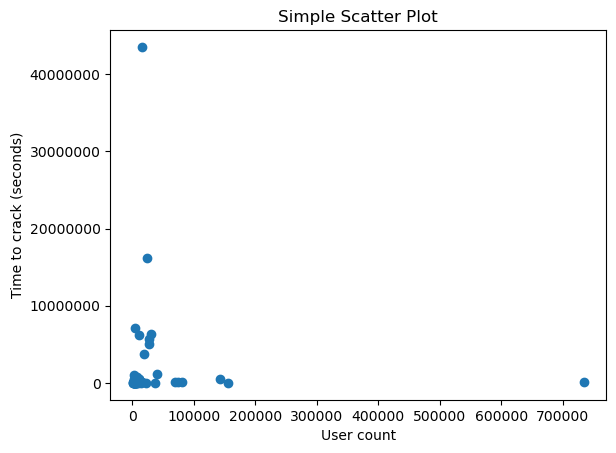

In [136]:
plt.scatter(df_countries.groupby("country")["User_count"].mean(), df_countries.groupby("country")["Time_to_crack_in_seconds"].mean())

# Adding labels and title
plt.xlabel('User count')
plt.ylabel('Time to crack (seconds)')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

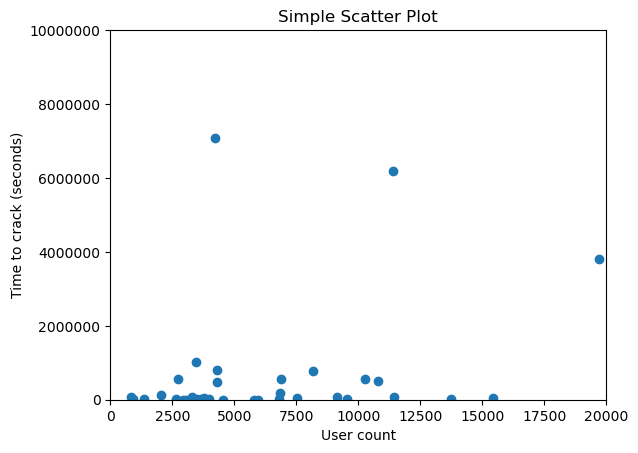

In [137]:
plt.scatter(df_countries.groupby("country")["User_count"].mean(), df_countries.groupby("country")["Time_to_crack_in_seconds"].mean())

# Adding labels and title
plt.xlabel('User count')
plt.ylabel('Time to crack (seconds)')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')
plt.xlim(0, 20000)  # Example: limit x-axis from 0 to 50,000 (adjust to your data)
plt.ylim(0, 10000000)  # Example: limit y-axis from 0 to 500 million (adjust to your data)


# Show the plot
plt.show()

# nothing else numerical and non-ordinal

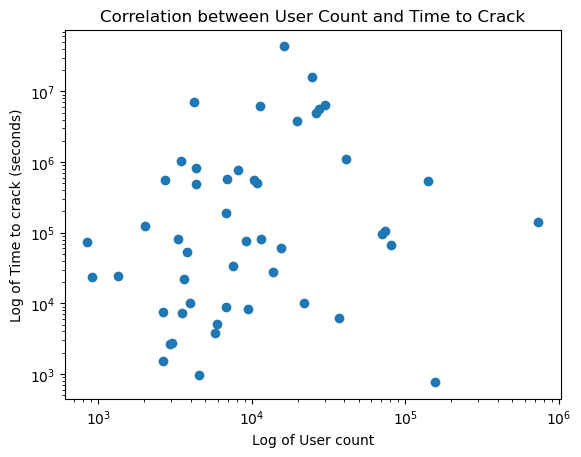

In [138]:
plt.scatter(df_countries.groupby("country")["User_count"].mean(), df_countries.groupby("country")["Time_to_crack_in_seconds"].mean())

# Adding labels and title
plt.xlabel('Log of User count')
plt.ylabel('Log of Time to crack (seconds)')
plt.title('Correlation between User Count and Time to Crack')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')
# plt.xlim(0, 20000)  # Example: limit x-axis from 0 to 50,000 (adjust to your data)
# plt.ylim(0, 10000000)  # Example: limit y-axis from 0 to 500 million (adjust to your data)
plt.xscale('log')  # Set x-axis to logarithmic scale
plt.yscale('log')  # Set y-axis to logarithmic scale

# Show the plot
plt.savefig("correlation-bad-log.png",dpi=300,transparent=True)
plt.show()

# nothing else numerical and non-ordinal

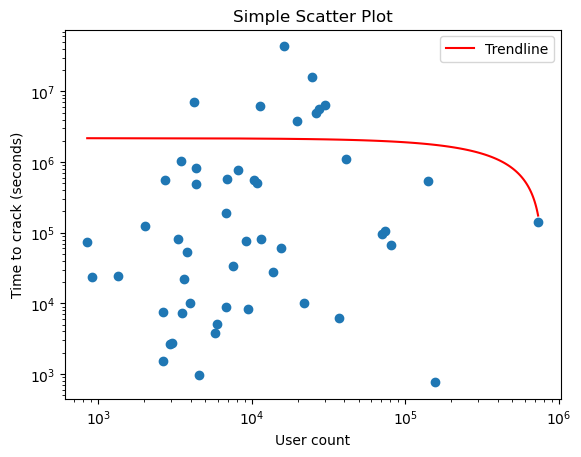

In [139]:
user_counts = df_countries.groupby("country")["User_count"].mean()
crack_times = df_countries.groupby("country")["Time_to_crack_in_seconds"].mean()

plt.scatter(user_counts, crack_times)

# Adding labels and title
plt.xlabel('User count')
plt.ylabel('Time to crack (seconds)')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')
# plt.xlim(0, 20000)  # Example: limit x-axis from 0 to 50,000 (adjust to your data)
# plt.ylim(0, 10000000)  # Example: limit y-axis from 0 to 500 million (adjust to your data)
plt.xscale('log')  # Set x-axis to logarithmic scale
plt.yscale('log')  # Set y-axis to logarithmic scale

# Fit a linear trendline (degree 1 polynomial) to the data
coefficients = np.polyfit(user_counts, crack_times, 1)  # Linear fit (degree 1)
polynomial = np.poly1d(coefficients)  # Create a polynomial function

# Generate x values for the trendline (you can use the same x values or create a range of x values)
x_values = np.linspace(user_counts.min(), user_counts.max(), 100)

# Plot the trendline
plt.plot(x_values, polynomial(x_values), color='red', label='Trendline')

# Show the legend
plt.legend()

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

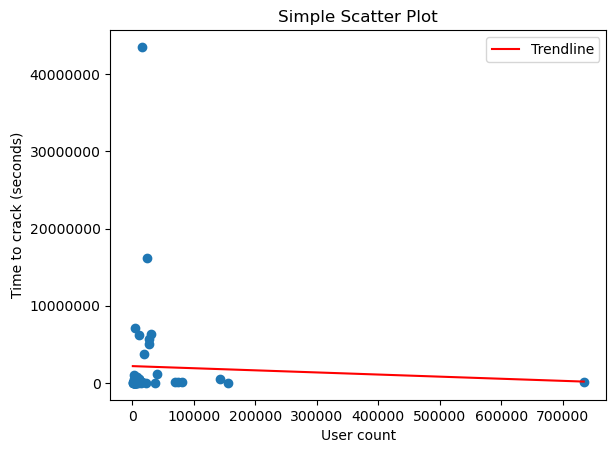

In [140]:
user_counts = df_countries.groupby("country")["User_count"].mean()
crack_times = df_countries.groupby("country")["Time_to_crack_in_seconds"].mean()

plt.scatter(user_counts, crack_times)

# Adding labels and title
plt.xlabel('User count')
plt.ylabel('Time to crack (seconds)')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')
# plt.xlim(0, 20000)  # Example: limit x-axis from 0 to 50,000 (adjust to your data)
# plt.ylim(0, 10000000)  # Example: limit y-axis from 0 to 500 million (adjust to your data)
# plt.xscale('log')  # Set x-axis to logarithmic scale
# plt.yscale('log')  # Set y-axis to logarithmic scale

# Fit a linear trendline (degree 1 polynomial) to the data
coefficients = np.polyfit(user_counts, crack_times, 1)  # Linear fit (degree 1)
polynomial = np.poly1d(coefficients)  # Create a polynomial function

# Generate x values for the trendline (you can use the same x values or create a range of x values)
x_values = np.linspace(user_counts.min(), user_counts.max(), 100)

# Plot the trendline
plt.plot(x_values, polynomial(x_values), color='red', label='Trendline')

# Show the legend
plt.legend()

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

In [141]:
from scipy.stats import pearsonr

corr_coefficient, p_value = pearsonr(user_counts, crack_times)

# Display the result
print(f"Pearson correlation coefficient: {corr_coefficient}")
print(f"P-value: {p_value}")

Pearson correlation coefficient: -0.04366520034120859
P-value: 0.7657734525495922


In [142]:
# enrich with upper, lower, symbols, digits, length for df_countries
df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,digits
1,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,chars
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800,True,Asia,chars
3,au,Australia,4,password1,86884,< 1 second,16.00,0,False,Asia,combo
4,au,Australia,5,123456789,75856,< 1 second,2.00,0,False,Asia,digits
...,...,...,...,...,...,...,...,...,...,...,...
9795,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800,True,Asia,chars
9796,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020,True,Asia,chars
9797,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800,True,Asia,chars
9798,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200,True,Asia,chars


In [143]:
length = []
digits = []
upper = []
lower = []
symbols = []

for password in df_countries["Password"]:
    length.append(len(password))
    
    digit_count = sum(c.isdigit() for c in password)
    digits.append(digit_count)

    upper_count = sum(c.isupper() for c in password)
    upper.append(upper_count)

    lower_count = sum(c.islower() for c in password)
    lower.append(lower_count)

    symbol_count = sum(not c.isalnum() for c in password)
    symbols.append(symbol_count)

df_countries["length"] = length
df_countries["digits"] = digits
df_countries["upper"] = upper
df_countries["lower"] = lower
df_countries["symbols"] = symbols
df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type,length,digits,upper,lower,symbols
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,digits,6,6,0,0,0
1,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,chars,8,0,0,8,0
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0
3,au,Australia,4,password1,86884,< 1 second,16.00,0,False,Asia,combo,9,1,0,8,0
4,au,Australia,5,123456789,75856,< 1 second,2.00,0,False,Asia,digits,9,9,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9795,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0
9796,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020,True,Asia,chars,7,0,0,7,0
9797,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0
9798,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200,True,Asia,chars,8,0,0,8,0


/var/folders/p1/w5y_34h54zs0lbj2lbcn6nt80000gn/T/ipykernel_51386/1310752414.py:18: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


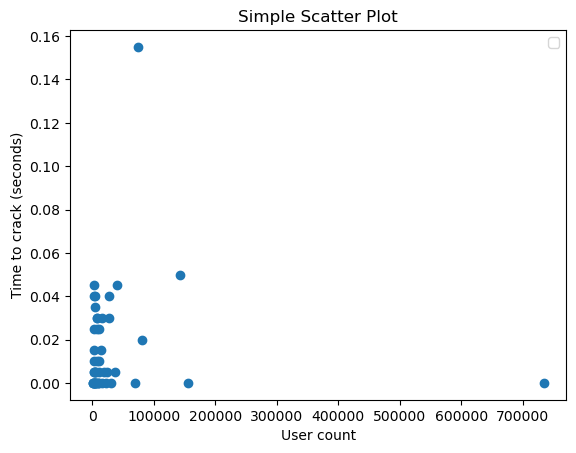

In [144]:
upper_counts = df_countries.groupby("country")["upper"].mean()
lower_counts = df_countries.groupby("country")["lower"].mean()
length_counts = df_countries.groupby("country")["length"].mean()
digits_counts = df_countries.groupby("country")["digits"].mean()
symbols_counts = df_countries.groupby("country")["symbols"].mean()

plt.scatter(user_counts, upper_counts)

# Adding labels and title
plt.xlabel('User count')
plt.ylabel('Time to crack (seconds)')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')

# Show the legend
plt.legend()

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

/var/folders/p1/w5y_34h54zs0lbj2lbcn6nt80000gn/T/ipykernel_51386/909444760.py:12: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


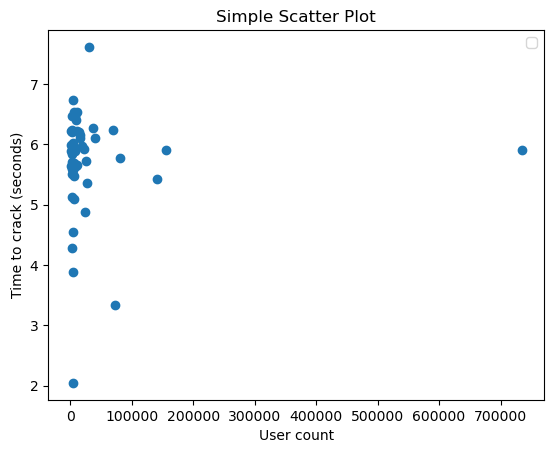

In [145]:
plt.scatter(user_counts, lower_counts)

# Adding labels and title
plt.xlabel('User count')
plt.ylabel('Time to crack (seconds)')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')

# Show the legend
plt.legend()

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

/var/folders/p1/w5y_34h54zs0lbj2lbcn6nt80000gn/T/ipykernel_51386/116879613.py:12: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


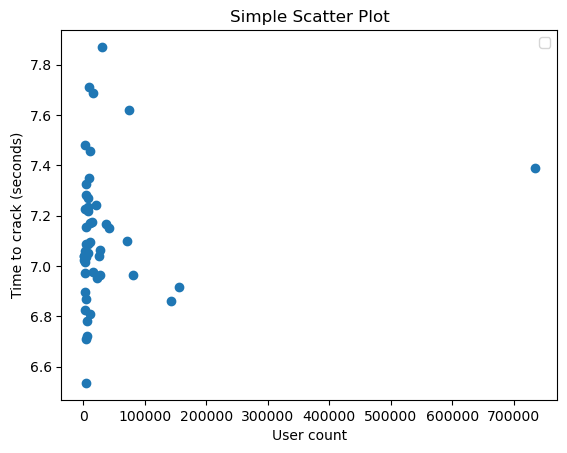

In [146]:
plt.scatter(user_counts, length_counts)

# Adding labels and title
plt.xlabel('User count')
plt.ylabel('Time to crack (seconds)')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')

# Show the legend
plt.legend()

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

/var/folders/p1/w5y_34h54zs0lbj2lbcn6nt80000gn/T/ipykernel_51386/2406665151.py:12: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


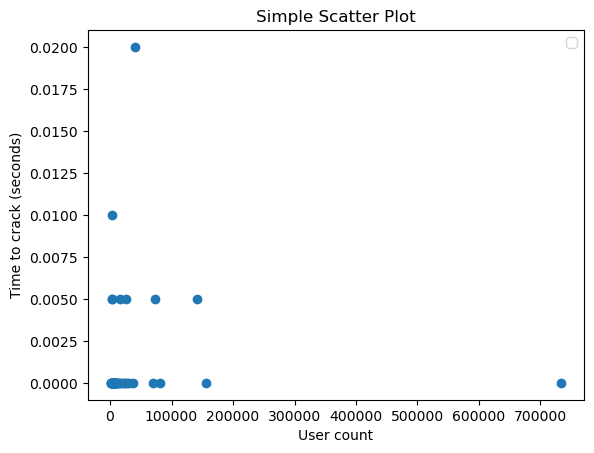

In [147]:
plt.scatter(user_counts, symbols_counts)

# Adding labels and title
plt.xlabel('User count')
plt.ylabel('Time to crack (seconds)')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')

# Show the legend
plt.legend()

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

/var/folders/p1/w5y_34h54zs0lbj2lbcn6nt80000gn/T/ipykernel_51386/1589472159.py:12: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


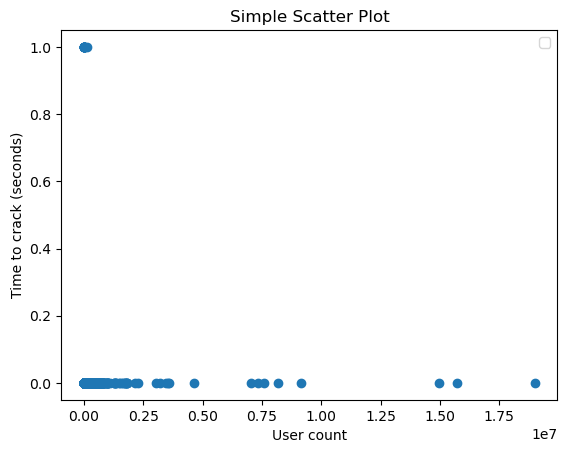

In [148]:
plt.scatter(df_countries["User_count"], df_countries["symbols"])

# Adding labels and title
plt.xlabel('User count')
plt.ylabel('Time to crack (seconds)')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')

# Show the legend
plt.legend()

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

/var/folders/p1/w5y_34h54zs0lbj2lbcn6nt80000gn/T/ipykernel_51386/2616574104.py:12: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


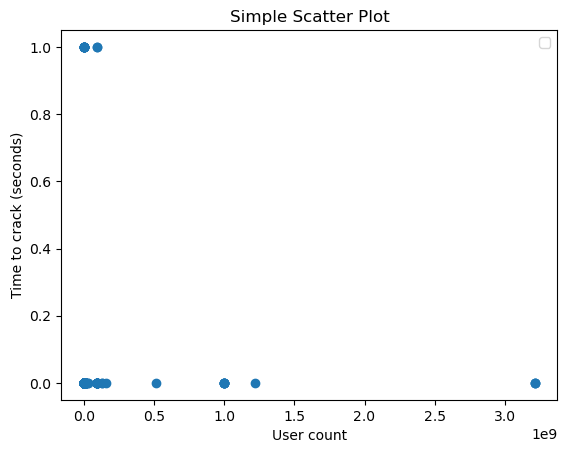

In [149]:
plt.scatter(df_countries["Time_to_crack_in_seconds"], df_countries["symbols"])

# Adding labels and title
plt.xlabel('User count')
plt.ylabel('Time to crack (seconds)')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')

# Show the legend
plt.legend()

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

In [150]:
df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type,length,digits,upper,lower,symbols
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,digits,6,6,0,0,0
1,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,chars,8,0,0,8,0
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0
3,au,Australia,4,password1,86884,< 1 second,16.00,0,False,Asia,combo,9,1,0,8,0
4,au,Australia,5,123456789,75856,< 1 second,2.00,0,False,Asia,digits,9,9,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9795,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0
9796,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020,True,Asia,chars,7,0,0,7,0
9797,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0
9798,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200,True,Asia,chars,8,0,0,8,0


In [151]:
correlation_matrix = df_countries[["User_count", "Time_to_crack_in_seconds", "length", "digits", "upper", "lower", "symbols"]].corr()
correlation_matrix

,User_count,Time_to_crack_in_seconds,length,digits,upper,lower,symbols
User_count,1.00,-0.00,-0.00,0.07,-0.00,-0.07,-0.00
Time_to_crack_in_seconds,-0.00,1.00,0.14,-0.02,-0.00,0.09,0.01
length,-0.00,0.14,1.00,0.17,0.07,0.39,0.03
digits,0.07,-0.02,0.17,1.00,0.01,-0.84,-0.00
upper,-0.00,-0.00,0.07,0.01,1.00,-0.05,0.16
lower,-0.07,0.09,0.39,-0.84,-0.05,1.00,-0.01
symbols,-0.00,0.01,0.03,-0.00,0.16,-0.01,1.00


/var/folders/p1/w5y_34h54zs0lbj2lbcn6nt80000gn/T/ipykernel_51386/3906197775.py:12: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


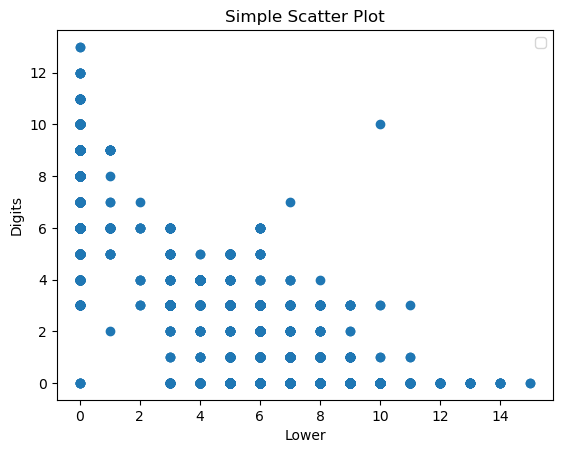

In [152]:
plt.scatter(df_countries["lower"], df_countries["digits"])

# Adding labels and title
plt.xlabel('Lower')
plt.ylabel('Digits')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')

# Show the legend
plt.legend()

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

In [153]:
correlation_matrix = df_countries[["country", "User_count", "Time_to_crack_in_seconds", "length", "digits", "upper", "lower", "symbols"]].groupby("country").mean().corr()
correlation_matrix

,User_count,Time_to_crack_in_seconds,length,digits,upper,lower,symbols
User_count,1.00,-0.04,0.13,0.02,0.00,0.02,0.00
Time_to_crack_in_seconds,-0.04,1.00,0.34,0.02,0.06,0.08,0.13
length,0.13,0.34,1.00,0.18,0.22,0.11,0.06
digits,0.02,0.02,0.18,1.00,0.46,-0.96,0.06
upper,0.00,0.06,0.22,0.46,1.00,-0.43,0.44
lower,0.02,0.08,0.11,-0.96,-0.43,1.00,-0.06
symbols,0.00,0.13,0.06,0.06,0.44,-0.06,1.00


In [154]:
correlation_matrix = df_countries[["Password", "User_count", "Time_to_crack_in_seconds", "length", "digits", "upper", "lower", "symbols"]].groupby("Password").mean().corr()
correlation_matrix

,User_count,Time_to_crack_in_seconds,length,digits,upper,lower,symbols
User_count,1.00,-0.01,0.01,0.06,0.02,-0.05,0.02
Time_to_crack_in_seconds,-0.01,1.00,0.18,-0.02,-0.00,0.14,0.01
length,0.01,0.18,1.00,0.17,0.09,0.54,0.05
digits,0.06,-0.02,0.17,1.00,0.05,-0.73,0.02
upper,0.02,-0.00,0.09,0.05,1.00,-0.11,0.15
lower,-0.05,0.14,0.54,-0.73,-0.11,1.00,-0.02
symbols,0.02,0.01,0.05,0.02,0.15,-0.02,1.00


In [155]:
correlation_matrix = df_countries[["Password", "country", "User_count", "Time_to_crack_in_seconds", "length", "digits", "upper", "lower", "symbols"]].groupby(["Password", "country"]).mean().corr()
correlation_matrix

,User_count,Time_to_crack_in_seconds,length,digits,upper,lower,symbols
User_count,1.00,-0.00,-0.00,0.08,-0.00,-0.07,-0.00
Time_to_crack_in_seconds,-0.00,1.00,0.14,-0.02,-0.00,0.09,0.01
length,-0.00,0.14,1.00,0.17,0.07,0.39,0.03
digits,0.08,-0.02,0.17,1.00,0.01,-0.84,-0.00
upper,-0.00,-0.00,0.07,0.01,1.00,-0.05,0.16
lower,-0.07,0.09,0.39,-0.84,-0.05,1.00,-0.01
symbols,-0.00,0.01,0.03,-0.00,0.16,-0.01,1.00


In [156]:
# try to enrich with yet another strength dataset
path = kagglehub.dataset_download("utkarshx27/passwords")
print(path)

/Users/nina/.cache/kagglehub/datasets/utkarshx27/passwords/versions/1


In [157]:
df_strength = pd.read_csv('/Users/nina/.cache/kagglehub/datasets/utkarshx27/passwords/versions/1/passwords.csv')
df_strength

,rank,password,category,value,time_unit,offline_crack_sec,rank_alt,strength,font_size
0,1.00,password,password-related,6.91,years,2.17,1.00,8.00,11.00
1,2.00,123456,simple-alphanumeric,18.52,minutes,0.00,2.00,4.00,8.00
2,3.00,12345678,simple-alphanumeric,1.29,days,0.00,3.00,4.00,8.00
3,4.00,1234,simple-alphanumeric,11.11,seconds,0.00,4.00,4.00,8.00
4,5.00,qwerty,simple-alphanumeric,3.72,days,0.00,5.00,8.00,11.00
...,...,...,...,...,...,...,...,...,...
502,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
503,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
504,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
505,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [158]:
df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type,length,digits,upper,lower,symbols
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,digits,6,6,0,0,0
1,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,chars,8,0,0,8,0
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0
3,au,Australia,4,password1,86884,< 1 second,16.00,0,False,Asia,combo,9,1,0,8,0
4,au,Australia,5,123456789,75856,< 1 second,2.00,0,False,Asia,digits,9,9,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9795,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0
9796,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020,True,Asia,chars,7,0,0,7,0
9797,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0
9798,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200,True,Asia,chars,8,0,0,8,0


In [159]:
# merge on perfect match
df_exact_match = pd.merge(df_countries, df_strength, left_on="Password", right_on="password", how='inner')
df_exact_match

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,...,symbols,rank,password,category,value,time_unit,offline_crack_sec,rank_alt,strength,font_size
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,...,0,2.00,123456,simple-alphanumeric,18.52,minutes,0.00,2.00,4.00,8.00
1,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,...,0,1.00,password,password-related,6.91,years,2.17,1.00,8.00,11.00
2,au,Australia,5,123456789,75856,< 1 second,2.00,0,False,Asia,...,0,49.00,123456789,simple-alphanumeric,1.84,weeks,0.01,49.00,4.00,8.00
3,au,Australia,6,12345,69344,< 1 second,3.00,0,False,Asia,...,0,6.00,12345,simple-alphanumeric,1.85,minutes,0.00,6.00,4.00,8.00
4,au,Australia,7,abc123,68434,< 1 second,15.00,0,False,Asia,...,0,13.00,abc123,simple-alphanumeric,3.70,weeks,0.02,13.00,32.00,23.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2637,vn,Vietnam,8,1234567,27162,< 1 second,10.00,0,False,Asia,...,0,24.00,1234567,simple-alphanumeric,3.09,hours,0.00,24.00,4.00,8.00
2638,vn,Vietnam,10,123123,22037,< 1 second,8.00,0,False,Asia,...,0,58.00,123123,simple-alphanumeric,18.52,minutes,0.00,58.00,7.00,11.00
2639,vn,Vietnam,88,12345,4912,< 1 second,3.00,0,False,Asia,...,0,6.00,12345,simple-alphanumeric,1.85,minutes,0.00,6.00,4.00,8.00
2640,vn,Vietnam,119,iloveyou,3937,< 1 second,22.00,0,False,Asia,...,0,99.00,iloveyou,fluffy,6.91,years,2.17,99.00,9.00,12.00


In [160]:
df_exact_match.groupby("strength").count()

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,...,lower,symbols,rank,password,category,value,time_unit,offline_crack_sec,rank_alt,font_size
strength,,,,,,,,,,,,,,,,,,,,,
0.00,260,260,260,260,260,260,219,260,260,260,...,260,260,260,260,260,260,260,260,260,260
1.00,32,32,32,32,32,32,23,32,32,32,...,32,32,32,32,32,32,32,32,32,32
2.00,3,3,3,3,3,3,0,3,3,3,...,3,3,3,3,3,3,3,3,3,3
3.00,3,3,3,3,3,3,0,3,3,3,...,3,3,3,3,3,3,3,3,3,3
4.00,417,417,417,417,417,417,399,417,417,417,...,417,417,417,417,417,417,417,417,417,417
5.00,77,77,77,77,77,77,38,77,77,77,...,77,77,77,77,77,77,77,77,77,77
6.00,220,220,220,220,220,220,60,220,220,220,...,220,220,220,220,220,220,220,220,220,220
7.00,302,302,302,302,302,302,156,302,302,302,...,302,302,302,302,302,302,302,302,302,302
8.00,893,893,893,893,893,893,509,893,893,893,...,893,893,893,893,893,893,893,893,893,893


In [161]:
pd.set_option("display.max_columns", None)
df_exact_match

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type,length,digits,upper,lower,symbols,rank,password,category,value,time_unit,offline_crack_sec,rank_alt,strength,font_size
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,digits,6,6,0,0,0,2.00,123456,simple-alphanumeric,18.52,minutes,0.00,2.00,4.00,8.00
1,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,chars,8,0,0,8,0,1.00,password,password-related,6.91,years,2.17,1.00,8.00,11.00
2,au,Australia,5,123456789,75856,< 1 second,2.00,0,False,Asia,digits,9,9,0,0,0,49.00,123456789,simple-alphanumeric,1.84,weeks,0.01,49.00,4.00,8.00
3,au,Australia,6,12345,69344,< 1 second,3.00,0,False,Asia,digits,5,5,0,0,0,6.00,12345,simple-alphanumeric,1.85,minutes,0.00,6.00,4.00,8.00
4,au,Australia,7,abc123,68434,< 1 second,15.00,0,False,Asia,combo,6,3,0,3,0,13.00,abc123,simple-alphanumeric,3.70,weeks,0.02,13.00,32.00,23.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2637,vn,Vietnam,8,1234567,27162,< 1 second,10.00,0,False,Asia,digits,7,7,0,0,0,24.00,1234567,simple-alphanumeric,3.09,hours,0.00,24.00,4.00,8.00
2638,vn,Vietnam,10,123123,22037,< 1 second,8.00,0,False,Asia,digits,6,6,0,0,0,58.00,123123,simple-alphanumeric,18.52,minutes,0.00,58.00,7.00,11.00
2639,vn,Vietnam,88,12345,4912,< 1 second,3.00,0,False,Asia,digits,5,5,0,0,0,6.00,12345,simple-alphanumeric,1.85,minutes,0.00,6.00,4.00,8.00
2640,vn,Vietnam,119,iloveyou,3937,< 1 second,22.00,0,False,Asia,chars,8,0,0,8,0,99.00,iloveyou,fluffy,6.91,years,2.17,99.00,9.00,12.00


In [162]:
correlation_matrix = df_exact_match[["User_count", "Time_to_crack_in_seconds", "length", "digits", "upper", "lower", "symbols", "strength"]].corr()
correlation_matrix

,User_count,Time_to_crack_in_seconds,length,digits,upper,lower,symbols,strength
User_count,1.00,-0.00,0.02,0.10,NaN,-0.09,NaN,-0.03
Time_to_crack_in_seconds,-0.00,1.00,0.03,-0.02,NaN,0.03,NaN,0.01
length,0.02,0.03,1.00,0.02,NaN,0.33,NaN,0.13
digits,0.10,-0.02,0.02,1.00,NaN,-0.94,NaN,-0.29
upper,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
lower,-0.09,0.03,0.33,-0.94,NaN,1.00,NaN,0.32
symbols,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
strength,-0.03,0.01,0.13,-0.29,NaN,0.32,NaN,1.00


In [163]:
df_exact_match.nunique()

country_code                  49
country                       49
Rank                         200
Password                     285
User_count                  2461
Time_to_crack                 21
Global_rank                   79
Time_to_crack_in_seconds      21
unique_password                2
region                         3
password_type                  3
length                         6
digits                        10
upper                          1
lower                          7
symbols                        1
rank                         285
password                     285
category                      10
value                         14
time_unit                      7
offline_crack_sec             15
rank_alt                     285
strength                      16
font_size                     14
dtype: int64

In [164]:
correlation_matrix = df_exact_match[["User_count", "Time_to_crack_in_seconds", "length", "digits", "lower", "strength"]].corr()
correlation_matrix

,User_count,Time_to_crack_in_seconds,length,digits,lower,strength
User_count,1.00,-0.00,0.02,0.10,-0.09,-0.03
Time_to_crack_in_seconds,-0.00,1.00,0.03,-0.02,0.03,0.01
length,0.02,0.03,1.00,0.02,0.33,0.13
digits,0.10,-0.02,0.02,1.00,-0.94,-0.29
lower,-0.09,0.03,0.33,-0.94,1.00,0.32
strength,-0.03,0.01,0.13,-0.29,0.32,1.00


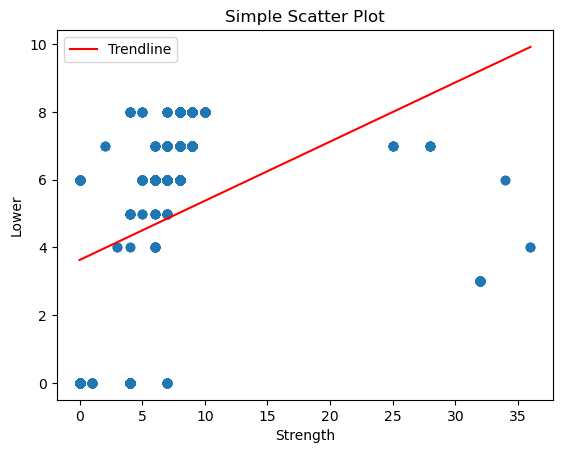

In [165]:
plt.scatter(df_exact_match["strength"], df_exact_match["lower"])

# Adding labels and title
plt.xlabel('Strength')
plt.ylabel('Lower')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')

# Fit a linear trendline (degree 1 polynomial) to the data
coefficients = np.polyfit(df_exact_match["strength"], df_exact_match["lower"], 1)  # Linear fit (degree 1)
polynomial = np.poly1d(coefficients)  # Create a polynomial function

# Generate x values for the trendline (you can use the same x values or create a range of x values)
x_values = np.linspace(df_exact_match["strength"].min(), df_exact_match["strength"].max(), 100)

# Plot the trendline
plt.plot(x_values, polynomial(x_values), color='red', label='Trendline')

# Show the legend
plt.legend()

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

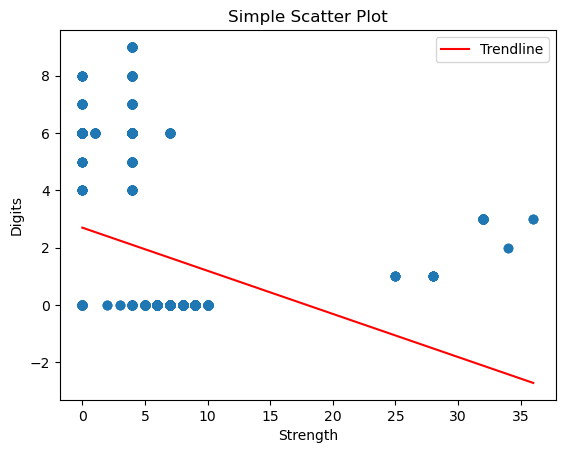

In [166]:
plt.scatter(df_exact_match["strength"], df_exact_match["digits"])

# Adding labels and title
plt.xlabel('Strength')
plt.ylabel('Digits')
plt.title('Simple Scatter Plot')

# Disable scientific notation on both axes
plt.ticklabel_format(style='plain', axis='y')

# Fit a linear trendline (degree 1 polynomial) to the data
coefficients = np.polyfit(df_exact_match["strength"], df_exact_match["digits"], 1)  # Linear fit (degree 1)
polynomial = np.poly1d(coefficients)  # Create a polynomial function

# Generate x values for the trendline (you can use the same x values or create a range of x values)
x_values = np.linspace(df_exact_match["strength"].min(), df_exact_match["strength"].max(), 100)

# Plot the trendline
plt.plot(x_values, polynomial(x_values), color='red', label='Trendline')

# Show the legend
plt.legend()

# Show the plot
plt.show()

# nothing else numerical and non-ordinal

In [167]:
length = []
digits = []
upper = []
lower = []
symbols = []

for password in df_strength["password"]:
    length.append(len(str(password)))
    
    digit_count = sum(c.isdigit() for c in str(password))
    digits.append(digit_count)

    upper_count = sum(c.isupper() for c in str(password))
    upper.append(upper_count)

    lower_count = sum(c.islower() for c in str(password))
    lower.append(lower_count)

    symbol_count = sum(not c.isalnum() for c in str(password))
    symbols.append(symbol_count)

df_strength["length"] = length
df_strength["digits"] = digits
df_strength["upper"] = upper
df_strength["lower"] = lower
df_strength["symbols"] = symbols
df_strength

,rank,password,category,value,time_unit,offline_crack_sec,rank_alt,strength,font_size,length,digits,upper,lower,symbols
0,1.00,password,password-related,6.91,years,2.17,1.00,8.00,11.00,8,0,0,8,0
1,2.00,123456,simple-alphanumeric,18.52,minutes,0.00,2.00,4.00,8.00,6,6,0,0,0
2,3.00,12345678,simple-alphanumeric,1.29,days,0.00,3.00,4.00,8.00,8,8,0,0,0
3,4.00,1234,simple-alphanumeric,11.11,seconds,0.00,4.00,4.00,8.00,4,4,0,0,0
4,5.00,qwerty,simple-alphanumeric,3.72,days,0.00,5.00,8.00,11.00,6,0,0,6,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
502,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,0,0,3,0
503,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,0,0,3,0
504,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,0,0,3,0
505,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,0,0,3,0


In [168]:
df_strength = df_strength.dropna(subset=['password', 'rank'])
df_strength

,rank,password,category,value,time_unit,offline_crack_sec,rank_alt,strength,font_size,length,digits,upper,lower,symbols
0,1.00,password,password-related,6.91,years,2.17,1.00,8.00,11.00,8,0,0,8,0
1,2.00,123456,simple-alphanumeric,18.52,minutes,0.00,2.00,4.00,8.00,6,6,0,0,0
2,3.00,12345678,simple-alphanumeric,1.29,days,0.00,3.00,4.00,8.00,8,8,0,0,0
3,4.00,1234,simple-alphanumeric,11.11,seconds,0.00,4.00,4.00,8.00,4,4,0,0,0
4,5.00,qwerty,simple-alphanumeric,3.72,days,0.00,5.00,8.00,11.00,6,0,0,6,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,496.00,reddog,cool-macho,3.72,days,0.00,498.00,6.00,10.00,6,0,0,6,0
496,497.00,alexande,name,6.91,years,2.17,499.00,9.00,12.00,8,0,0,8,0
497,498.00,college,nerdy-pop,3.19,months,0.08,500.00,7.00,11.00,7,0,0,7,0
498,499.00,jester,name,3.72,days,0.00,501.00,7.00,11.00,6,0,0,6,0


In [169]:
df_strength.nunique()
# no upper and symbols in the current dataset

rank                 500
password             500
category              10
value                 15
time_unit              7
offline_crack_sec     16
rank_alt             500
strength              22
font_size             19
length                 6
digits                10
upper                  1
lower                  8
symbols                1
dtype: int64

In [171]:
# multiple linear regression, where you want to predict a single value (strength) based on multiple features (like digit count, length, etc.).
# training stage
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error

# Step 1: Define your features (independent variables) and target (dependent variable)
X = df_strength[['length', 'digits', 'lower']]
y = df_strength['strength']

# Step 2: Split into training and testing sets (optional but recommended) - this is my training set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 3: Create and train the linear regression model
model = LinearRegression()
model.fit(X, y)

# Step 4: Evaluate the model
y_pred = model.predict(X)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

# Step 5: Print results
# print("R² Score:", r2)
# print("Mean Squared Error:", mse)
print("Coefficients:", model.coef_)
print("Intercept:", model.intercept_)

ValueError: Found input variables with inconsistent numbers of samples: [100, 500]

In [173]:

# Step 1: Define your features (independent variables) and target (dependent variable)
X = df_strength[['length', 'digits', 'lower']]
y = df_strength['strength']

# Step 2: Split into training and testing sets (optional but recommended)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 3: Create and train the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Step 4: Evaluate the model
y_pred = model.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

# Step 5: Print results
print("R² Score:", r2)
print("Mean Squared Error:", mse)
print("Coefficients:", model.coef_)
print("Intercept:", model.intercept_)


R² Score: 0.09727486190002044
Mean Squared Error: 36.855017578125
Coefficients: [ 6.60185343e+13 -6.60185343e+13 -6.60185343e+13]
Intercept: -0.8200000000000003


In [175]:
# dropped some extra columns by hand cause couldn't read it in - they were all for the same password "simlan"?
df_strength_classifier = pd.read_csv('/Users/nina/data/password_strength.csv')
df_strength_classifier

,password,strength
0,kzde5577,1
1,kino3434,1
2,visi7k1yr,1
3,megzy123,1
4,lamborghin1,1
...,...,...
669635,10redtux10,1
669636,infrared1,1
669637,184520socram,1
669638,marken22a,1


In [241]:
df_strength_classifier.describe()

,strength,length,digits,upper,lower,symbols
count,"669,640.00","669,640.00","669,640.00","669,640.00","669,640.00","669,640.00"
mean,0.99,9.99,3.18,0.80,5.97,0.05
std,0.51,2.82,2.00,2.28,2.38,0.34
min,0.00,1.00,0.00,0.00,0.00,0.00
25%,1.00,8.00,2.00,0.00,5.00,0.00
50%,1.00,9.00,3.00,0.00,6.00,0.00
75%,1.00,11.00,4.00,0.00,7.00,0.00
max,2.00,220.00,39.00,80.00,164.00,21.00


In [177]:
length = []
digits = []
upper = []
lower = []
symbols = []

for password in df_strength_classifier["password"]:
    length.append(len(str(password)))
    
    digit_count = sum(c.isdigit() for c in str(password))
    digits.append(digit_count)

    upper_count = sum(c.isupper() for c in str(password))
    upper.append(upper_count)

    lower_count = sum(c.islower() for c in str(password))
    lower.append(lower_count)

    symbol_count = sum(not c.isalnum() for c in str(password))
    symbols.append(symbol_count)

df_strength_classifier["length"] = length
df_strength_classifier["digits"] = digits
df_strength_classifier["upper"] = upper
df_strength_classifier["lower"] = lower
df_strength_classifier["symbols"] = symbols
df_strength_classifier

,password,strength,length,digits,upper,lower,symbols
0,kzde5577,1,8,4,0,4,0
1,kino3434,1,8,4,0,4,0
2,visi7k1yr,1,9,2,0,7,0
3,megzy123,1,8,3,0,5,0
4,lamborghin1,1,11,1,0,10,0
...,...,...,...,...,...,...,...
669635,10redtux10,1,10,4,0,6,0
669636,infrared1,1,9,1,0,8,0
669637,184520socram,1,12,6,0,6,0
669638,marken22a,1,9,2,0,7,0


In [179]:
df_strength_classifier.groupby("strength").count()

,password,length,digits,upper,lower,symbols
strength,,,,,,
0,89701,89702,89702,89702,89702,89702
1,496801,496801,496801,496801,496801,496801
2,83137,83137,83137,83137,83137,83137


In [181]:
df_strength_classifier.nunique()

password    669506
strength         3
length          49
digits          27
upper           26
lower           37
symbols         19
dtype: int64

In [183]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

X = df_strength_classifier[['length', 'digits', 'lower', "upper", "symbols"]]
y = df_strength_classifier['strength']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

model = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=1000)
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

print(classification_report(y_test, y_pred))

/Users/nina/anaconda3/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


              precision    recall  f1-score   support

           0       1.00      1.00      1.00     18005
           1       1.00      1.00      1.00     99335
           2       1.00      1.00      1.00     16588

    accuracy                           1.00    133928
   macro avg       1.00      1.00      1.00    133928
weighted avg       1.00      1.00      1.00    133928



In [185]:

# Step 1: Define your features (independent variables) and target (dependent variable)
X = df_strength_classifier[['length', 'digits', 'lower', "upper", "symbols"]]
y = df_strength_classifier['strength']

# Step 2: Split into training and testing sets (optional but recommended)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 3: Create and train the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Step 4: Evaluate the model
y_pred = model.predict(X_test)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

# Step 5: Print results
print("R² Score:", r2)
print("Mean Squared Error:", mse)
print("Coefficients:", model.coef_)
print("Intercept:", model.intercept_)


R² Score: 0.6836839585779484
Mean Squared Error: 0.08122613079149552
Coefficients: [-0.10369774  0.25467437  0.23962695  0.26720833  0.22241463]
Intercept: -0.43654143475764784


In [187]:
df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type,length,digits,upper,lower,symbols
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,digits,6,6,0,0,0
1,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,chars,8,0,0,8,0
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0
3,au,Australia,4,password1,86884,< 1 second,16.00,0,False,Asia,combo,9,1,0,8,0
4,au,Australia,5,123456789,75856,< 1 second,2.00,0,False,Asia,digits,9,9,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9795,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0
9796,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020,True,Asia,chars,7,0,0,7,0
9797,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0
9798,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200,True,Asia,chars,8,0,0,8,0


In [189]:
predicted_strength = model.predict(df_countries[['length', 'digits', 'lower', "upper", "symbols"]])

# Add predictions back into the new_data frame (optional)
df_countries['predicted_strength'] = predicted_strength
df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type,length,digits,upper,lower,symbols,predicted_strength
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,digits,6,6,0,0,0,0.47
1,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,chars,8,0,0,8,0,0.65
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0,0.65
3,au,Australia,4,password1,86884,< 1 second,16.00,0,False,Asia,combo,9,1,0,8,0,0.80
4,au,Australia,5,123456789,75856,< 1 second,2.00,0,False,Asia,digits,9,9,0,0,0,0.92
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9795,vn,Vietnam,196,hongngoc,2660,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0,0.65
9796,vn,Vietnam,197,anhtien,2628,17 Minutes,NaN,1020,True,Asia,chars,7,0,0,7,0,0.51
9797,vn,Vietnam,198,lanhuong,2620,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0,0.65
9798,vn,Vietnam,199,congacon,2584,2 Hours,NaN,7200,True,Asia,chars,8,0,0,8,0,0.65


In [191]:
pd.set_option('display.max_rows', None)
df_countries[df_countries["country"]=="Indonesia"]

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type,length,digits,upper,lower,symbols,predicted_strength
3400,id,Indonesia,1,12345,548280,< 1 second,3.00,0,False,Asia,digits,5,5,0,0,0,0.32
3401,id,Indonesia,2,123456,524448,< 1 second,1.00,0,False,Asia,digits,6,6,0,0,0,0.47
3402,id,Indonesia,3,123456789,189852,< 1 second,2.00,0,False,Asia,digits,9,9,0,0,0,0.92
3403,id,Indonesia,4,12345678,88965,< 1 second,6.00,0,False,Asia,digits,8,8,0,0,0,0.77
3404,id,Indonesia,5,password,81424,< 1 second,5.00,0,False,Asia,chars,8,0,0,8,0,0.65
3405,id,Indonesia,6,1234567890,59675,< 1 second,9.00,0,False,Asia,digits,10,10,0,0,0,1.07
3406,id,Indonesia,7,bismillah,58368,1 Day,NaN,86400,False,Asia,chars,9,0,0,9,0,0.79
3407,id,Indonesia,8,1234567,55208,< 1 second,10.00,0,False,Asia,digits,7,7,0,0,0,0.62
3408,id,Indonesia,9,qwerty,54589,< 1 second,4.00,0,False,Asia,chars,6,0,0,6,0,0.38
3409,id,Indonesia,10,rahasia,50811,17 Minutes,NaN,1020,True,Asia,chars,7,0,0,7,0,0.51


In [193]:
sorted_df_countries = df_countries.sort_values(by="predicted_strength", ascending=False)
sorted_df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type,length,digits,upper,lower,symbols,predicted_strength
7139,ru,Russia,140,1q2w3e4r5t6y7u8i9o0p,100667,10 Months,NaN,26784000,True,Europe/Africa,combo,20,10,0,10,0,2.43
7983,es,Spain,184,gabinphilippeau,6337,6 Months,NaN,16070400,False,Europe/Africa,chars,15,0,0,15,0,1.60
3580,id,Indonesia,181,gabinphilippeau,3536,6 Months,NaN,16070400,False,Asia,chars,15,0,0,15,0,1.60
7148,ru,Russia,149,1q2w3e4r5t6y7u,97493,28 Seconds,NaN,28,True,Europe/Africa,combo,14,7,0,7,0,1.57
1320,cn,China,121,1233211234567,10985,27 Days,NaN,2332800,True,Asia,digits,13,13,0,0,0,1.53
2966,gr,Greece,167,1234567890123,755,2 Seconds,NaN,2,True,Europe/Africa,digits,13,13,0,0,0,1.53
3837,il,Israel,38,blackcoffee333,3529,5 Days,NaN,432000,True,Asia,combo,14,3,0,11,0,1.51
6764,pt,Portugal,165,nouhailalalala,3104,22 Hours,NaN,79200,False,Europe/Africa,chars,14,0,0,14,0,1.47
3495,id,Indonesia,96,kallynlavallee,5840,Centuries,NaN,3214080000,True,Asia,chars,14,0,0,14,0,1.47
793,br,Brazil,194,estantevirtual,5475,Centuries,NaN,3214080000,True,Americas,chars,14,0,0,14,0,1.47


In [239]:
sorted_df_countries = df_countries.sort_values(by="symbols", ascending=False)
sorted_df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type,length,digits,upper,lower,symbols,predicted_strength,weighed_strength
9030,ae,United Arab Emirates,31,P@ssw0rd,2179,< 1 second,NaN,0,False,Asia,combo,8,1,1,5,1,0.68,"1,473.68"
3531,id,Indonesia,132,P@ssw0rd,4815,< 1 second,NaN,0,False,Asia,combo,8,1,1,5,1,0.68,"3,256.43"
3332,in,India,133,pass@123,9564,2 Minutes,NaN,120,True,Asia,combo,8,3,0,4,1,0.68,"6,492.26"
966,ca,Canada,167,N0=Acc3ss,10876,1 Minute,NaN,60,True,Americas,combo,9,2,2,4,1,0.85,"9,297.53"
7611,za,South Africa,12,P@ssw0rd,5548,< 1 second,NaN,0,False,Europe/Africa,combo,8,1,1,5,1,0.68,"3,752.16"
2643,de,Germany,44,wall.e,123317,2 Minutes,NaN,120,True,Europe/Africa,combo,6,0,0,5,1,0.36,"44,618.74"
7379,sa,Saudi Arabia,180,Saudi Arabia,154,3 Years,NaN,96422400,True,Asia,combo,12,0,2,9,1,1.23,189.81
7764,za,South Africa,165,P@ssword,1112,< 1 second,NaN,0,True,Europe/Africa,combo,8,0,1,6,1,0.66,735.32
3271,in,India,72,P@ssw0rd,18301,< 1 second,NaN,0,False,Asia,combo,8,1,1,5,1,0.68,"12,377.13"
1245,cn,China,46,163.com,17975,17 Minutes,NaN,1020,True,Asia,combo,7,3,0,3,1,0.54,"9,758.50"


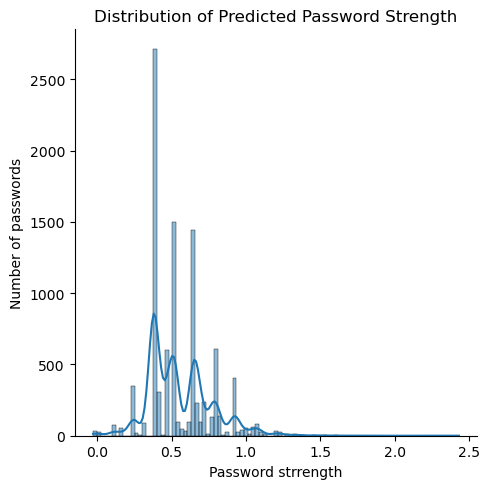

In [194]:
sns.displot(df_countries['predicted_strength'], kde=True)
plt.title('Distribution of Predicted Password Strength')
plt.xlabel('Password strrength')
plt.ylabel('Number of passwords')
plt.tight_layout()
plt.savefig("histogram-password-strength.png",dpi=300,transparent=True)
plt.show()

In [195]:
df_countries['predicted_strength'].describe()

count   9,800.00
mean        0.55
std         0.21
min        -0.03
25%         0.38
50%         0.51
75%         0.65
max         2.43
Name: predicted_strength, dtype: float64

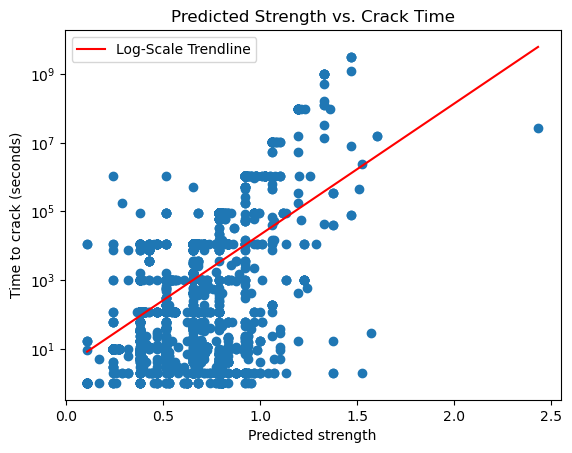

In [196]:
# Drop or filter out 0 or negative values (log is undefined there)
df_plot = df_countries[["predicted_strength", "Time_to_crack_in_seconds"]].dropna()
df_plot = df_plot[df_plot["Time_to_crack_in_seconds"] > 0]

# Scatter plot
plt.scatter(df_plot["predicted_strength"], df_plot["Time_to_crack_in_seconds"])
plt.xlabel('Predicted strength')
plt.ylabel('Time to crack (seconds)')
plt.title('Predicted Strength vs. Crack Time')
plt.yscale('log')

# Fit linear trendline on the LOG of Y values
log_crack_time = np.log10(df_plot["Time_to_crack_in_seconds"])
coefficients = np.polyfit(df_plot["predicted_strength"], log_crack_time, 1)
polynomial = np.poly1d(coefficients)

# Create smooth x values for the line
x_values = np.linspace(df_plot["predicted_strength"].min(), df_plot["predicted_strength"].max(), 100)

# Compute the corresponding y values (then raise 10^ to map back to original scale)
log_y_values = polynomial(x_values)
y_values = 10 ** log_y_values

# Plot trendline
plt.plot(x_values, y_values, color='red', label='Log-Scale Trendline')

plt.legend()
# plt.savefig("scatter-good.png",dpi=300,transparent=True)
plt.show()


/Users/nina/anaconda3/anaconda3/lib/python3.12/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


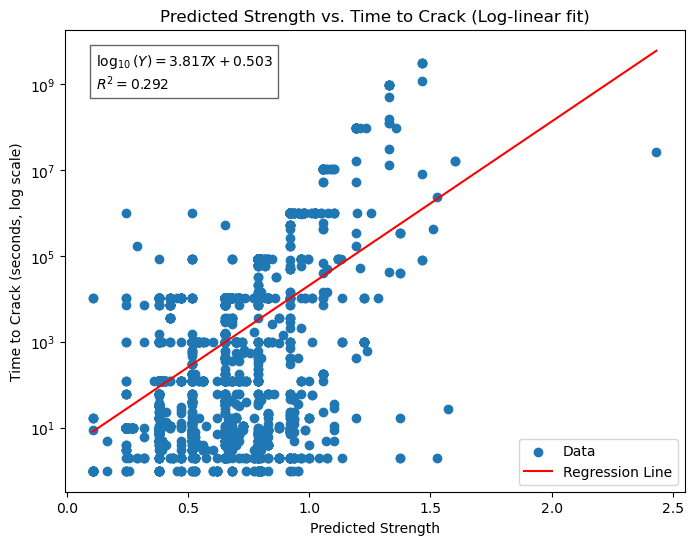

In [215]:
from sklearn.metrics import r2_score

# Filter and prepare data
df_plot = df_countries[["predicted_strength", "Time_to_crack_in_seconds"]].dropna()
df_plot = df_plot[df_plot["Time_to_crack_in_seconds"] > 0]

X = df_plot[["predicted_strength"]]
y_log = np.log10(df_plot["Time_to_crack_in_seconds"])

# Fit linear regression on log-transformed Y
model = LinearRegression()
model.fit(X, y_log)

# Extract model parameters
slope = model.coef_[0]
intercept = model.intercept_
r2 = r2_score(y_log, model.predict(X))

# Prepare line for plotting
x_line = np.linspace(X.min(), X.max(), 100).reshape(-1, 1)
y_log_line = model.predict(x_line)
y_line = 10 ** y_log_line  # Back to original scale

# Create the equation string
equation = fr"$\log_{{10}}(Y) = {slope:.3f}X + {intercept:.3f}$" + f"\n$R^2 = {r2:.3f}$"

# Plot
plt.figure(figsize=(8, 6))
plt.scatter(df_plot["predicted_strength"], df_plot["Time_to_crack_in_seconds"], label="Data")
plt.plot(x_line, y_line, color='red', label="Regression Line")
plt.xlabel('Predicted Strength')
plt.ylabel('Time to Crack (seconds, log scale)')
plt.title('Predicted Strength vs. Time to Crack (Log-linear fit)')
plt.yscale('log')
plt.legend()
plt.text(0.05, 0.95, equation, transform=plt.gca().transAxes,
         fontsize=10, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.6))
plt.savefig("scatter-good.png",dpi=300,transparent=True)
plt.show()


In [203]:
corr_coefficient, p_value = pearsonr(df_plot["predicted_strength"], log_crack_time)

# Display the result
print(f"Pearson correlation coefficient: {corr_coefficient}")
print(f"P-value: {p_value}")

Pearson correlation coefficient: 0.540594838610475
P-value: 0.0


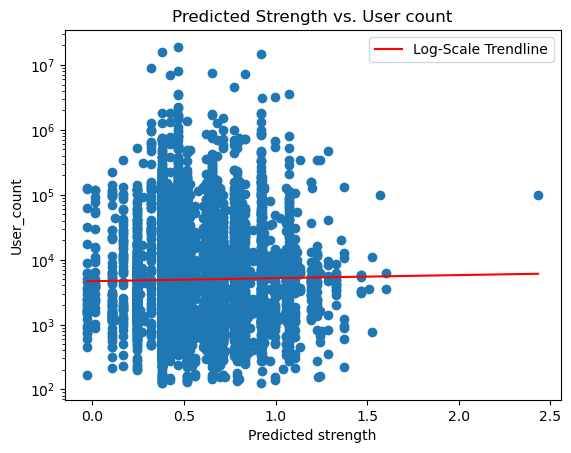

In [205]:
# Drop or filter out 0 or negative values (log is undefined there)
df_plot = df_countries[["predicted_strength", "User_count"]].dropna()
df_plot = df_plot[df_plot["User_count"] > 0]

# Scatter plot
plt.scatter(df_plot["predicted_strength"], df_plot["User_count"])
plt.xlabel('Predicted strength')
plt.ylabel('User_count')
plt.title('Predicted Strength vs. User count')
plt.yscale('log')

# Fit linear trendline on the LOG of Y values
log_user_count = np.log10(df_plot["User_count"])
coefficients = np.polyfit(df_plot["predicted_strength"], log_user_count, 1)
polynomial = np.poly1d(coefficients)

# Create smooth x values for the line
x_values = np.linspace(df_plot["predicted_strength"].min(), df_plot["predicted_strength"].max(), 100)

# Compute the corresponding y values (then raise 10^ to map back to original scale)
log_y_values = polynomial(x_values)
y_values = 10 ** log_y_values

# Plot trendline
plt.plot(x_values, y_values, color='red', label='Log-Scale Trendline')

plt.legend()
plt.show()


In [207]:
correlation_matrix = df_countries[["Time_to_crack_in_seconds", "predicted_strength", "User_count"]].corr()
correlation_matrix

,Time_to_crack_in_seconds,predicted_strength,User_count
Time_to_crack_in_seconds,1.00,0.13,-0.00
predicted_strength,0.13,1.00,0.01
User_count,-0.00,0.01,1.00


In [209]:
#line with color by region  - line plot- avg password strength per country
# password strength * user count / user count sum (average password strength per user)

In [210]:
mean_predicted_strengths = df_countries.groupby(["country", "region"])[["predicted_strength"]].mean().reset_index()
mean_predicted_strengths

,country,region,predicted_strength
0,Australia,Asia,0.52
1,Austria,Europe/Africa,0.51
2,Belgium,Europe/Africa,0.54
3,Brazil,Americas,0.55
4,Canada,Americas,0.53
5,Chile,Americas,0.57
6,China,Asia,0.67
7,Colombia,Americas,0.57
8,Czech Republic,Europe/Africa,0.51
9,Denmark,Europe/Africa,0.54


In [212]:
mean_predicted_strengths_sorted = mean_predicted_strengths.sort_values(by="predicted_strength").reset_index()
mean_predicted_strengths_sorted

,index,country,region,predicted_strength
0,37,Slovak Republic,Europe/Africa,0.48
1,15,Hungary,Europe/Africa,0.49
2,22,Korea,Asia,0.49
3,38,South Africa,Europe/Africa,0.50
4,40,Sweden,Europe/Africa,0.50
5,8,Czech Republic,Europe/Africa,0.51
6,1,Austria,Europe/Africa,0.51
7,13,Germany,Europe/Africa,0.52
8,47,United States,Americas,0.52
9,41,Switzerland,Europe/Africa,0.52


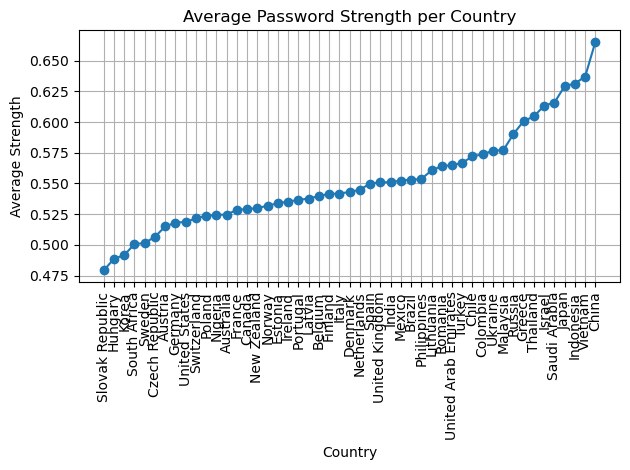

In [217]:
plt.plot(mean_predicted_strengths_sorted["country"], mean_predicted_strengths_sorted["predicted_strength"], marker='o')

# Labels
plt.xlabel("Country")
plt.ylabel("Average Strength")
plt.title("Average Password Strength per Country")
plt.xticks(rotation=90)
plt.tight_layout()
plt.grid(True)

plt.show()

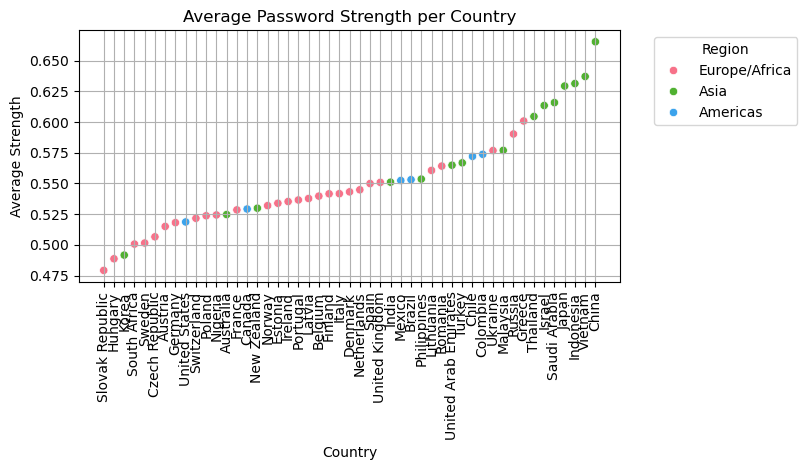

In [237]:
sns.scatterplot(data=mean_predicted_strengths_sorted,
                x="country",
                y="predicted_strength",
                hue="region",
                palette="husl")

plt.xlabel("Country")
plt.ylabel("Average Strength")
plt.title("Average Password Strength per Country")
plt.xticks(rotation=90)
plt.tight_layout()
plt.grid(True)
plt.legend(title="Region", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig("strength-country.png",dpi=300,transparent=True)
plt.show()

In [221]:
# another take at this
df_countries["weighed_strength"] = df_countries["predicted_strength"] * df_countries["User_count"]
df_countries

,country_code,country,Rank,Password,User_count,Time_to_crack,Global_rank,Time_to_crack_in_seconds,unique_password,region,password_type,length,digits,upper,lower,symbols,predicted_strength,weighed_strength
0,au,Australia,1,123456,308483,< 1 second,1.00,0,False,Asia,digits,6,6,0,0,0,0.47,"144,776.74"
1,au,Australia,2,password,191880,< 1 second,5.00,0,False,Asia,chars,8,0,0,8,0,0.65,"124,893.20"
2,au,Australia,3,lizottes,98220,3 Hours,NaN,10800,True,Asia,chars,8,0,0,8,0,0.65,"63,930.64"
3,au,Australia,4,password1,86884,< 1 second,16.00,0,False,Asia,combo,9,1,0,8,0,0.80,"69,669.58"
4,au,Australia,5,123456789,75856,< 1 second,2.00,0,False,Asia,digits,9,9,0,0,0,0.92,"69,958.06"
5,au,Australia,6,12345,69344,< 1 second,3.00,0,False,Asia,digits,5,5,0,0,0,0.32,"22,075.09"
6,au,Australia,7,abc123,68434,< 1 second,15.00,0,False,Asia,combo,6,3,0,3,0,0.42,"29,028.07"
7,au,Australia,8,qwerty,67130,< 1 second,4.00,0,False,Asia,chars,6,0,0,6,0,0.38,"25,444.54"
8,au,Australia,9,12345678,37675,< 1 second,6.00,0,False,Asia,digits,8,8,0,0,0,0.77,"29,057.66"
9,au,Australia,10,holden,30844,2 Minutes,NaN,120,False,Asia,chars,6,0,0,6,0,0.38,"11,690.92"


In [223]:
sum_weighed_strengths = df_countries.groupby(["country", "region"])[["weighed_strength", "User_count"]].sum().reset_index()
sum_weighed_strengths

,country,region,weighed_strength,User_count
0,Australia,Asia,"1,670,281.53",3083341
1,Austria,Europe/Africa,"361,155.38",695307
2,Belgium,Europe/Africa,"409,367.13",729661
3,Brazil,Americas,"2,644,047.08",4943358
4,Canada,Americas,"2,826,785.59",5277926
5,Chile,Americas,"482,112.57",846354
6,China,Asia,"8,700,503.02",14739683
7,Colombia,Americas,"820,628.96",1379631
8,Czech Republic,Europe/Africa,"1,176,505.76",2288530
9,Denmark,Europe/Africa,"455,048.03",862571


In [225]:
sum_weighed_strengths["weighed_average"] = sum_weighed_strengths["weighed_strength"]/sum_weighed_strengths["User_count"]
sum_weighed_strengths

,country,region,weighed_strength,User_count,weighed_average
0,Australia,Asia,"1,670,281.53",3083341,0.54
1,Austria,Europe/Africa,"361,155.38",695307,0.52
2,Belgium,Europe/Africa,"409,367.13",729661,0.56
3,Brazil,Americas,"2,644,047.08",4943358,0.53
4,Canada,Americas,"2,826,785.59",5277926,0.54
5,Chile,Americas,"482,112.57",846354,0.57
6,China,Asia,"8,700,503.02",14739683,0.59
7,Colombia,Americas,"820,628.96",1379631,0.59
8,Czech Republic,Europe/Africa,"1,176,505.76",2288530,0.51
9,Denmark,Europe/Africa,"455,048.03",862571,0.53


In [227]:
mean_weighed_strengths_sorted = sum_weighed_strengths.sort_values(by="weighed_average").reset_index()
mean_weighed_strengths_sorted

,index,country,region,weighed_strength,User_count,weighed_average
0,15,Hungary,Europe/Africa,"559,382.11",1159682,0.48
1,42,Thailand,Asia,"1,014,801.29",2055344,0.49
2,33,Portugal,Europe/Africa,"1,146,155.81",2282038,0.50
3,22,Korea,Asia,"457,297.74",910432,0.50
4,37,Slovak Republic,Europe/Africa,"353,045.93",702289,0.50
5,8,Czech Republic,Europe/Africa,"1,176,505.76",2288530,0.51
6,29,Nigeria,Europe/Africa,"391,657.42",757126,0.52
7,40,Sweden,Europe/Africa,"619,682.10",1194218,0.52
8,39,Spain,Europe/Africa,"2,852,521.72",5493452,0.52
9,1,Austria,Europe/Africa,"361,155.38",695307,0.52


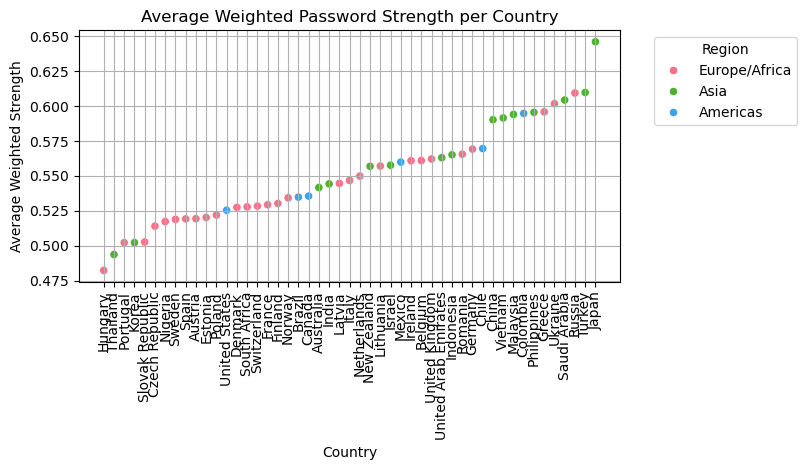

In [235]:
sns.scatterplot(data=mean_weighed_strengths_sorted,
                x="country",
                y="weighed_average",
                hue="region",
                palette="husl")

plt.xlabel("Country")
plt.ylabel("Average Weighted Strength")
plt.title("Average Weighted Password Strength per Country")
plt.xticks(rotation=90)
plt.tight_layout()
plt.grid(True)
plt.legend(title="Region", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig("weighted-strength-country.png",dpi=300,transparent=True)
plt.show()
# population taken into account